<a href="https://colab.research.google.com/github/RonBartov/Deep_Learning_Basics/blob/main/Assignment4_Variational_Autoencoders.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Assignment 4 - Variational Autoencoders**

In this assignment, we will train a model to produce new human faces with variational autoencoders (VAEs). 
Variational autoencoders let us design complex generative models of data, and fit them to large datasets. They can generate images of fictional celebrity faces (as we'll do in this assignment), high-resolution digital artwork and many more tasks. These models also yield state-of-the-art machine learning results in image generation and reinforcement learning. Variational autoencoders (VAEs) were defined in 2013 by Kingma and Wellings [1].

In this assignment, you will build, train and analyze a VAE with the CelebA dataset. You will analyze how well images can be reconstructed from the lower dimensional representations and try to generate images that look similar to the images in the CelebA dataset.

[1] Kingma, Diederik P., and Max Welling. "Auto-encoding variational bayes." arXiv preprint arXiv:1312.6114 (2013). 


# **Section 1: Variational Autoencoders**


Let us recall the structure of the variational autoencoder:

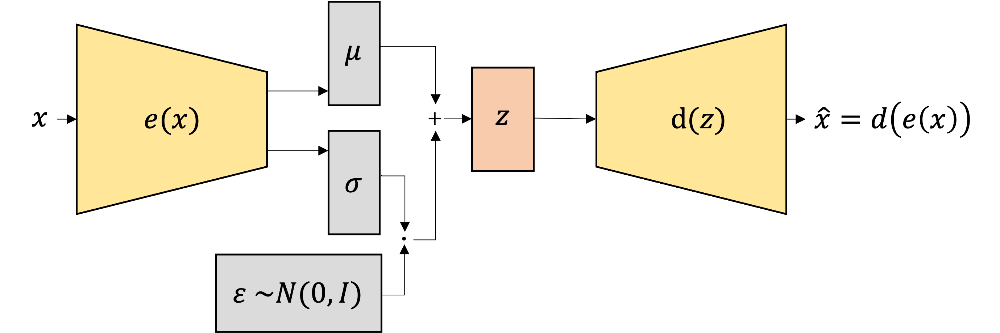

**Imports**

Before we begin, we import the needed libraries. 


You may modify the starter code as you see fit, including changing the signatures of
functions and adding/removing helper functions. However, please make sure that we can understand what you are doing and why.

In [ ]:
from torchvision import datasets
from torchvision import transforms
from torch.autograd import Variable
import torch
import torch.nn as nn
import torch.nn.functional as nnF
from torchvision.utils import make_grid
from IPython.display import Image
import matplotlib.pyplot as plt
import numpy as np
import random
import torchvision.transforms.functional as F
from torchvision.utils import make_grid
import os
import zipfile

%pip install wget   
import wget

# use GPU for computation if possible: Go to RUNTIME -> CHANGE RUNTIME TYPE -> GPU
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9674 sha256=dfe74aca6ee87c762362f832d565981b614ccf705698dec163e6cad1425f8649
  Stored in directory: /root/.cache/pip/wheels/bd/a8/c3/3cf2c14a1837a4e04bd98631724e81f33f462d86a1d895fae0
Successfully built wget


Connect to your Google Drive, select the path in your drive for saving the checkpoints of your model, which we will train later.

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')


# Path to save the dataset.
# Ron's path
#PATH_TO_SAVE_MODEL = '/content/gdrive/MyDrive/Projects/VAE_Assigment4' 

# Aviv's path
PATH_TO_SAVE_MODEL = '/content/gdrive/MyDrive/DP_course/ex4/checkpoints'


Mounted at /content/gdrive


Define random seeds in order to reproduce your results.

In [ ]:
# TO DO: Set random seeds - to your choice
torch.manual_seed(50)         # Insert any integer
torch.cuda.manual_seed(50)    # Insert any integer

## Question 1. Basic Principles (10 %)




# **Part (a) -- 3%**

What is the difference between deterministic autoencoder we saw in class and the variational autoencoder? 

##**Answer:**

The goal of deterministic autoencoders is to reconstruct the input, i.e to learn the unit mapping, and this leaning rely on the updating action of a deterministic parameters ${\theta}$ and ${\phi}$ . For a fixed input, the output will always be the same. 


In contrast, the goal of variational autoencoders is to learn a generative model, which will allow us to generate random realizations from complex
spaces. That is why the VAE learns a probability distribution and not a fixed parameters. The decoder then samples from this distribution to produce a reconstruction of the input. This randomness allows VAEs to be more flexible and to capture more complex patterns in the data.

# **Part (b) -- 3%**
In which manner Variational Autoencoder is trained? Explain.

## **Answer:**

VAEs are trained to maximize a lower bound on the log-likelihood of the training data under the model, which means that the goal is to learn a distribution over the data that is as close as possible to the true distribution of the data.

Here, the latent is a random variable, and its distribution is dictated by the encoder mapping, namely $z{\sim}q({\cdot}|y)$.

Then, the decoder can learn how to
map a random variable from some tractable distribution into the (possibly intractable) input space
𝒴. This allows using the probabilistic decoder as kind of a generative model.


# **Part (c) -- 4%**

In class we saw another generative model, known as generative adversarial network (GAN). What are the differences in terms of task objective between GANs and VAEs? Give an example for a task which a VAE is more suitable than GAN, and vice versa.

## **Answer:**

A GAN consists of two models: a generator and a discriminator. The generator produces synthetic data, and the discriminator tries to distinguish the synthetic data from real data. The two models are trained in an adversarial manner, where the generator tries to produce data that can fool the discriminator, and the discriminator tries to accurately identify whether a given data point is real or synthetic.

The VAE is **trained by minimizing the reconstruction error between the input data and the synthetic data produced by the decoder**.

According to the above, we can say that the task objective of a GAN is to generate synthetic data that is indistinguishable from real data to some discriminator model.On the other hand, the task objective of a VAE is to learn a compact latent representation of the data (probability distribution) and **then** generate synthetic data by **sampling from this latent representation**.


**One example of a task where a VAE might be more suitable than a GAN:** 

Anomaly detection- VAEs can learn a compact representation of the scanned data, thus data points that are far from the learned distribution in latent space are likely to have high reconstruction errors when passed through the decoder. These high reconstruction errors can be used as a measure of anomaly. 
In contrast, GANs do not have a latent representation of the data

**One example of a task where a VAE might be more suitable than a GAN:** 
Generate high-quality images- GANs directly generate synthetic data, while VAEs must generate data via a latent representation, which can introduce reconstruction errors.


# **Question 2. Data (15 %)**

In this assignement we are using the CelebFaces Attributes Dataset (CelebA).

The CelebA dataset, as its name suggests, is comprised of celebrity faces. The images cover large pose variations, background clutter, diverse people, supported by a large quantity of images and rich annotations. This data was originally collected by researchers at MMLAB, The Chinese University of Hong Kong.

**Overall**

- 202,599 number of face images of various celebrities
- 10,177 unique identities, but names of identities are not given
- 40 binary attribute annotations per image
- 5 landmark locations

In this torchvision version of the dataset, each image is in the shape of
$[218,178,3]$ and the values are in $[0,1]$.

Here, you will download the dataset to the Google Colab disk. It is highly recommended not to download the dataset to your own Google Drive account since it is time consuming.

**Ron's comment** 

We can use '!ls' command to see what files are using the colab disk

In [ ]:
data_path = '/content/Assignment4_Celeba' # path on google colab disk!

base_url = "https://graal.ift.ulaval.ca/public/celeba/"

file_list = [
    "img_align_celeba.zip",
    "list_attr_celeba.txt",
    "identity_CelebA.txt",
    "list_bbox_celeba.txt",
    "list_landmarks_align_celeba.txt",
    "list_eval_partition.txt",
]

# Path to folder with the dataset
dataset_folder = f"{data_path}/celeba"
os.makedirs(dataset_folder, exist_ok=True)

for file in file_list:
    url = f"{base_url}/{file}"
    if not os.path.exists(f"{dataset_folder}/{file}"):
        wget.download(url, f"{dataset_folder}/{file}")

with zipfile.ZipFile(f"{dataset_folder}/img_align_celeba.zip", "r") as ziphandler:
    ziphandler.extractall(dataset_folder)

# **Part (a) -- 5%**

Apply transformations:

The data is given as PIL (Python Imageing Library) images. Since we are working with PyTorch, we wish to apply transformations to the data in order to process it properly.

Here you should apply transformations to the data. There are many kinds of transformations which can be found here: https://pytorch.org/vision/stable/transforms.html. Note that transformations can be chained together using Compose method.

Think which transformations can be suitable for this task and apply it in the form of: 

trfm = transforms.Compose([transforms.transform1(),transforms.transform2(),...])

We recommend to consider:
- transforms.ToTensor()
- transforms.Resize()

# **Some transormation we are considering to add:**

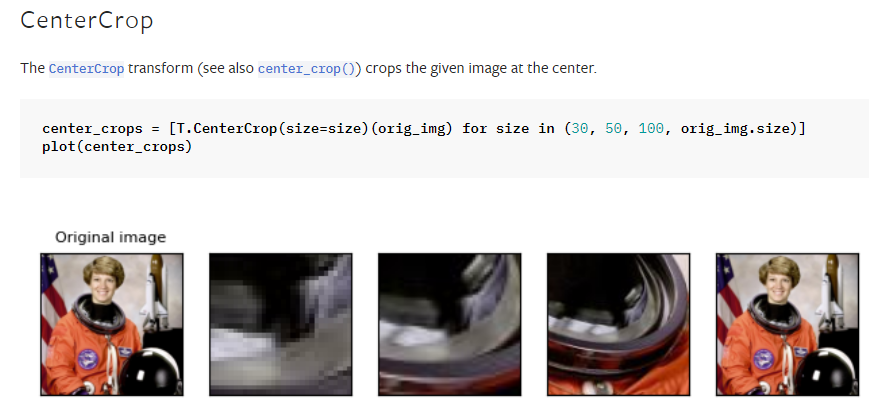



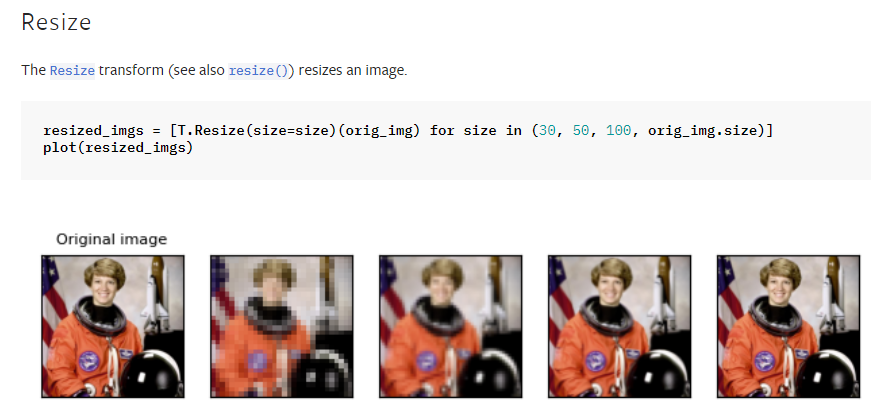





# **About datasets.CelebA**

The CelebA dataset is typically split into a training set and a testing set. The exact split of the data into training and testing sets can vary, but a common split is to use around 160,000 images for training and the remaining images for testing.

You can use the torchvision.datasets.CelebA dataset class to load the CelebA dataset in PyTorch. This class provides a number of options for preprocessing and loading the data, including the ability to specify the split of the data into training and testing sets.

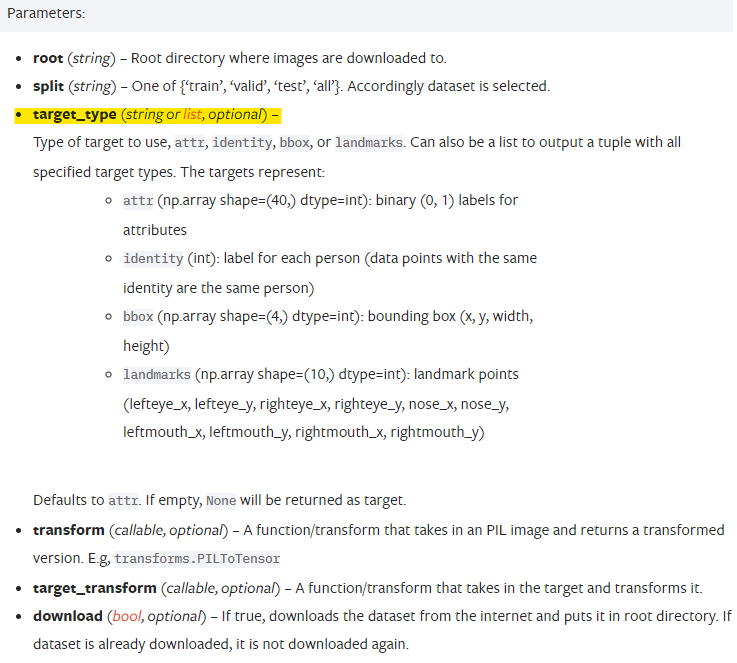


**An example of how to use it:**

train_dataset = datasets.CelebA(root='path/to/celeba', train=True, download=True,split='train', transform=transform)
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size,num_workers=num_workers, shuffle=True)

the training data will not be different every time we run the code. The CelebA dataset is a fixed dataset that does not change.

However, the order in which the data is returned by the train_loader will be different each time we iterate through it, due to the shuffle=True argument passed to the DataLoader. This causes the data to be shuffled randomly each time you start a new epoch.

In [ ]:
trfm = transforms.Compose([transforms.ToTensor(),transforms.Resize((218,178))])

training_data = datasets.CelebA(root=data_path, split='train', download=False, transform=trfm) # load the dataset (without download it directly) from our root directory on google drive disk. 
test_data = datasets.CelebA(root=data_path, split='test', download=False, transform=trfm)
val_data = datasets.CelebA(root=data_path, split='valid', download=False, transform = trfm)

# **Checking the size of our data**

In [ ]:
# train and test
train_len = len(training_data) 
test_len = len(test_data)

print('train length is: ', train_len)
print('test length is: ', test_len)
print('the total length of test and train is : ', train_len + test_len)

train length is:  162770
test length is:  19962
the total length of test and train is :  182732


In [ ]:
## Tried to calculate mean and std in order to normalize the training data but it takes to long (wanted to use transforms.Normalize(mean=mean, std=std) )

# dataloader = torch.utils.data.DataLoader(training_data, batch_size=500, shuffle=True) # torch.utils.data.DataLoader is a PyTorch utility class that provides a convenient iterator over a dataset.

# # Initialize variables to store the mean and standard deviation
# mean = 0
# std = 0

# # Iterate over the dataloader and compute the mean and standard deviation
# for images, _ in dataloader:
#     mean += images.mean(dim=[0, 2, 3]) # [0,2,3] is [batch,height,width]
#     std += images.std(dim=[0, 2, 3])

# mean /= len(dataloader.dataset)
# std /= len(dataloader.dataset)
# type(training_data) 

# **Part (b) -- 5%**

In order to get in touch with the dataset, and to see what we are dealing with (which is always recommended), we wish to visualize some data samples from the CelebA dataset.

Write a function: show():

INPUT: Python list of length 32 where each element is an image, randomly selected from the training data.

OUTOUT: Showing a 8X4 grid of images.

In [ ]:
def show(imgs, nrows=8, ncols=4):
    # Create a figure with the specified number of rows and columns
    fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 20))

    # Squeeze the ax array to remove singleton dimensions
    ax = ax.squeeze()

    # Loop through the images and plot each one on a subplot
    for i, image in enumerate(imgs):
        if np.shape(image) == (3,218,178):  
          image = image.swapaxes(0,2).swapaxes(0,1)

        # Get the Axes object for the subplot
        subplot = fig.axes[i]
        subplot.imshow(image, cmap='Greys_r')

    # Remove the axis labels and tick marks from the subplots
    for a in fig.axes:
        a.axis('off')

    # Display the figure
    plt.show()
    return None

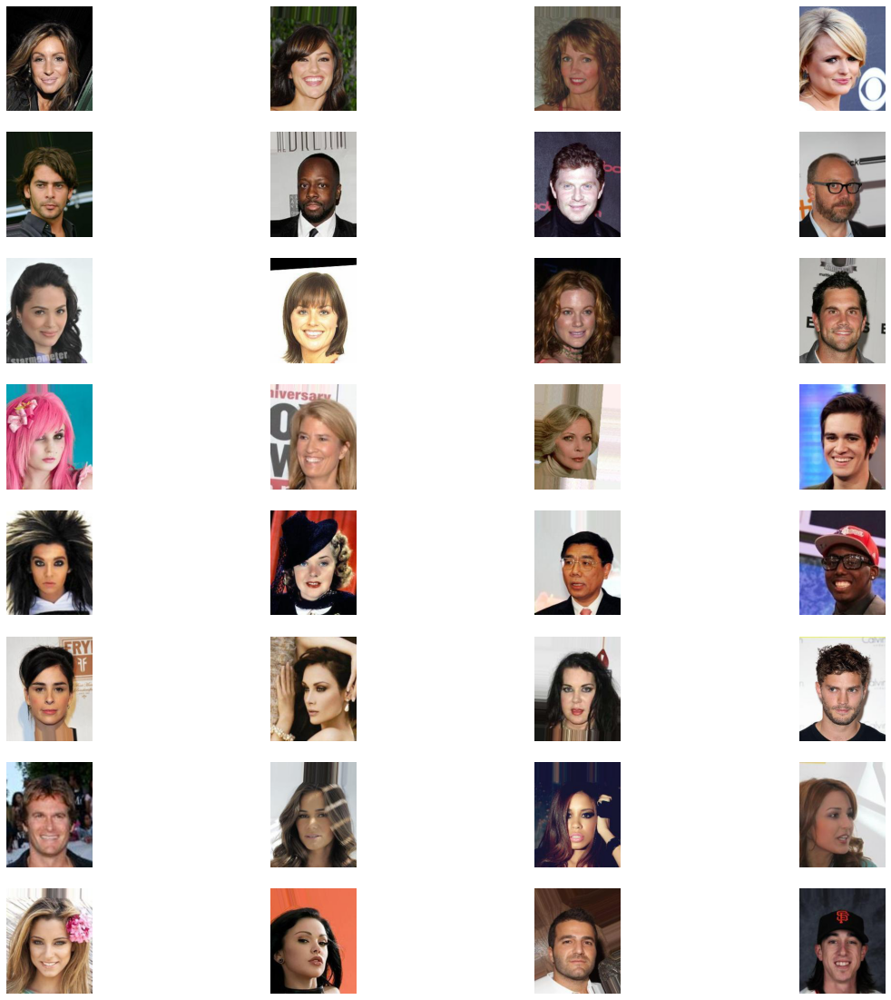

In [ ]:
## Plot 32 images for example

# load data from training data set
dataloader = torch.utils.data.DataLoader(training_data, batch_size=32, shuffle=True)

lst_img = []

# Store 32 images in lst_img
for i in range(32):
  image, _ = next(iter(dataloader))

  # Convert the image tensor to a NumPy array
  image = image.numpy()[0]
  image = image.swapaxes(0,2).swapaxes(0,1)
  lst_img.append(image)

# Display the image using the imshow function
show(lst_img)


# **Part (c) -- 5%**

Extrapolate in the image domain:

Here, randomly take 2 images from the training dataset, combine them together and plot the result. For example, consider $X_1$ and $X_2$ to be 2 images randomly taken from the training data. Plot $\alpha\cdot X_1 + (1-\alpha)\cdot X_2$. 

Explain the results, is extrapolation in the image domain reasonable?

Note: Recall that the images should be in the $[0,1]$ interval.

In [ ]:
# load the data from training data set
dataloader = torch.utils.data.DataLoader(training_data, batch_size=2, shuffle=True)
image1, _ = next(iter(dataloader))
image2, _ = next(iter(dataloader))

image1 = image1.numpy()[0]
image2 = image2.numpy()[0]


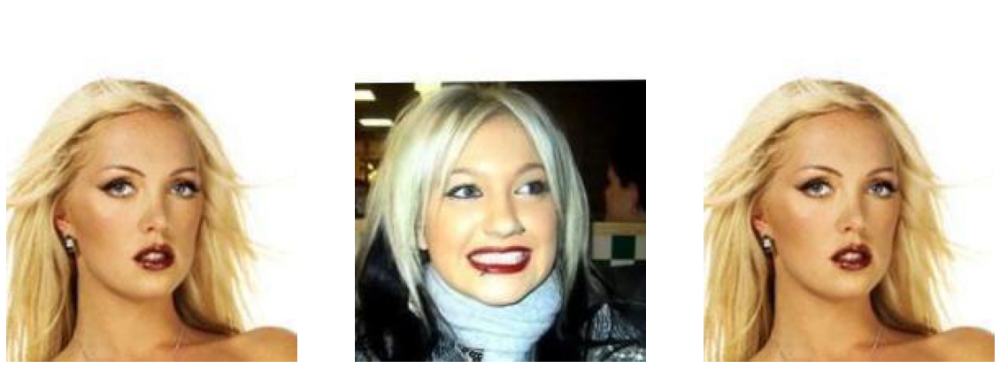

In [ ]:
alpha = 1 
summed_image = alpha*image1 + (1-alpha)*image2
show([image1,image2,summed_image],1,3)

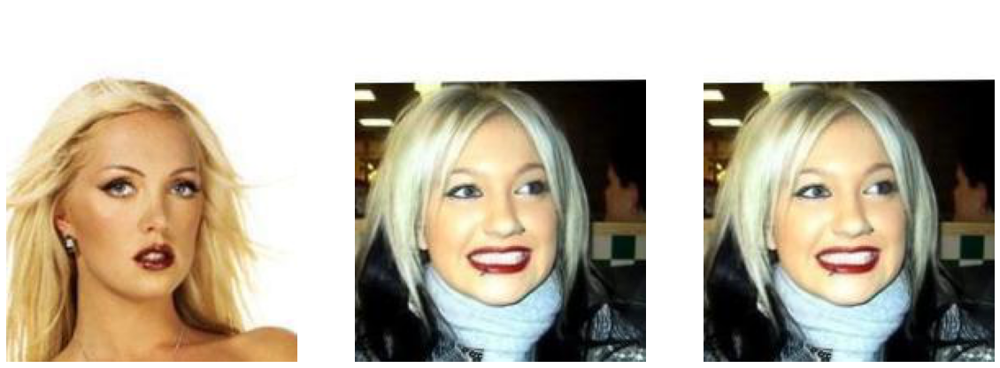

In [ ]:
alpha = 0
summed_image = alpha*image1 + (1-alpha)*image2
show([image1,image2,summed_image],1,3)

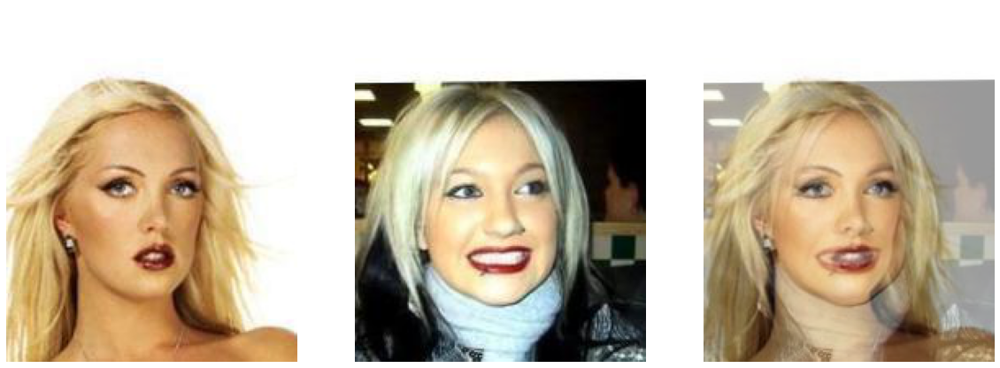

In [ ]:
alpha = 0.6
summed_image = alpha*image1 + (1-alpha)*image2
show([image1,image2,summed_image],1,3)

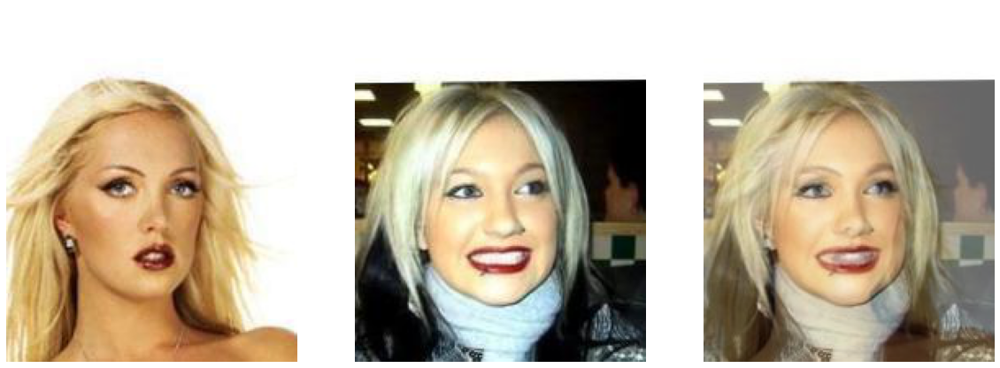

In [ ]:
alpha = 0.4
summed_image = alpha*image1 + (1-alpha)*image2
show([image1,image2,summed_image],1,3)

## **Answer:**

Combining two images by taking a weighted sum of their pixel values is a type of image interpolation (estimating the value of a pixel at a position that does not correspond to an actual pixel in the image)

According to that, we are expecting from the results to changed for ech specific image and the value of α. If the two images are very different from each other, the resulting image may appear to be a blend of the two images, with some features from one image and some features from the other image. If the two images are similar, the resulting image may appear to be an enhanced version of one of the images, with increased contrast or sharpness.

In addition, if the resulting pixel values fall outside of the valid range, the image may be distorted. In this case, we will have to clamp the pixel values to the valid range before displaying the image. In our case we chose α to be in the range [0,1], thus we will not encounter such a situation. 

## Question 3. VAE Foundations (15 %)


Let us start by recalling the analytical derivation of the VAE.


The simplest version of VAE is comprised of an encoder-decoder architecture.
The *encoder* is a neural network which its input is a datapoint $x$, its output is a hidden representation $z$, and it has weights and biases $\theta$. We denote the encoder's mapping by $P_{\theta}(z|x)$. The *decoder* is another neural network which its input is the data sample $z$, its output is the reconstructed input $x$, and its parameters $\phi$. Hence, we denote the decoder's mapping by $P_{\phi}(x|z)$.

The goal is to determine a posterior distribution $P_{\theta}(z|x)$ of a latent variable $z$ given some data evidence $x$. However, determining this posterior distribution is typically computationally intractable, because according to Bayes:

$(1)$ $P(z|x) = \frac{P(x|z)P(z)}{P(x)}$

The term $P(x)$ is called the evidence, and we can calculate it by marginalization on the latent variable:

$P(x) = \int_{z}P(x|z)P(z)dz$

Unfortunately, this term is intractable because it requires computation of the integral over the entire latent space $z$. To bypass this intractability problem we approximate the posterior distribution with some other distribution $q(z|x_i)$. This approximation is made by the KL-divergence:

$(2)$ $D_{KL}\big(q(z|x_i)||P(z|x_i)\big) = \int_{z}q(z|x_i)\cdot\log\big(\frac{q(z|x_i)}{P(z|x_i)}\big)dz = -\int_{z}q(z|x_i)\cdot\log\big(\frac{P(z|x_i)}{q(z|x_i)}\big)dz \geq 0$

Applying Bayes’ theorem to the above equation yields,

$(3)$ $D_{KL}\big(q(z|x_i)||P(z|x_i)\big) = -\int_{z}q(z|x_i)\cdot\log\big(\frac{P(x_i|z)P(z)}{q(z|x_i)P(x_i)}\big)dz \geq 0$

This can be broken down using laws of logarithms, yielding,

$(4)$ $-\int_{z}q(z|x_i)\cdot\big[\log\big(\frac{P(x_i|z)P(z)}{q(z|x_i)}\big)-\log(P(x_i))\big]dz \geq 0$

Distributing the integrand then yields,

$(5)$ $-\int_{z}q(z|x_i)\cdot\log\big(\frac{P(x_i|z)P(z)}{q(z|x_i)}\big)dz+\int_{z}q(z|x_i)\log(P(x_i))dz \geq 0$

In the above, we note that $log(P(x))$ is a constant and can therefore be pulled out of the second integral above, yielding,

$(6)$ $-\int_{z}q(z|x_i)\cdot\log\big(\frac{P(x_i|z)P(z)}{q(z|x_i)}\big)dz+\log(P(x_i))\int_{z}q(z|x_i)dz \geq 0$

And since $q(z|x_i)$ is a probability distribution it integrates to 1 in the above equation, yielding,

$(7)$ $-\int_{z}q(z|x_i)\cdot\log\big(\frac{P(x_i|z)P(z)}{q(z|x_i)}\big)dz+\log(P(x_i)) \geq 0$

Then carrying the integral over to the other side of the inequality, we get,

$(8)$ $\log(P(x_i)) \geq \int_{z}q(z|x_i)\cdot\log\big(\frac{P(x_i|z)P(z)}{q(z|x_i)}\big)dz$

<!-- Applying rules of logarithms, we get,

$(9)$ $\log(P(x)) \geq \int_{z}q(z|x)\cdot\big[\log\big(P(x|z)\big)+\log\big(P(z)\big)-\log\big(q(z|x)\big)\big]dz$

Recognizing the right hand side of the above inequality as Expectation, we write,

$(10)$ $\log(P(x)) \geq E_{~q(z|x)}\big[\log\big(P(x,z)\big)-\log\big(q(z|x)\big)\big]dz$ -->

From Equation $(8)$ it follows that:

$(9)$ $\log(P(x_i)) \geq \int_{z}q(z|x_i)\cdot\log\big(\frac{P(z)}{q(z|x_i)}\big)dz + \int_{z}q(z|x_i)\cdot\log\big(P(x_i|z)\big)dz$

Which is equivalent to:

$(10)$ $\log(P(x_i)) \geq -D_{KL}\big(q(z|x_i)||P(z)\big) + E_{~q(z|x_i)}\big[\log\big(P(x_i|z)\big)\big]$



The right hand side of the above equation is the Evidence Lower BOund (ELBO). Its bounds $\log(P(x))$ which is the term we seek to maximize. Therefore, maximizing the ELBO maximizes the log probability of our data. 


# **Part (a) -- 5%**
 A we see above, the $ELBO = -D_{KL}\big(q(z|x_i)||P(z)\big) + E_{~q(z|x_i)}\big[\log\big(P(x_i|z)\big)\big]$ is comprised of 2 terms. Explain the meaning of each one of them in terms of a loss function.



## **Answer:**

Loss function is made in order to help us to fix our network parameters according to some measure of distance netween the real expected result and the approximated result. 

The meaning of each part in the ELBO is the following:

1) $D_{KL}(q_{θ}(z|y)||p_{ϕ}(z))$ which captures the similarity between the learned probabilistic encoder and the desired marginal of the latent.

2) $−Ez_{∼q_{θ}(z|y)}{log p_{ϕ}(y|z)}$ which describes the accuracy of the decoder in matching the input distribution

# **Part (b) -- 10%**

 As we saw in class, in traditional variational autoencoder we assume:

$P(z)$ ~ $N(\mu_p,\sigma_{p}^2) = \frac{1}{\sqrt{2\pi\sigma_{p}^2}}\exp\big(-\frac{(z-\mu_p)^2}{2\sigma_{p}^2}\big)$

and

$q(z|x)$ ~ $N(\mu_q,\sigma_{q}^2) = \frac{1}{\sqrt{2\pi\sigma_{q}^2}}\exp\big(-\frac{(z-\mu_q)^2}{2\sigma_{q}^2}\big)$

Assume $\mu_p = 0$ and $\sigma_{p}^2 = 1$. Show that:

$ -D_{KL}\big(q(z|x_i)||P(z)\big) = \frac{1}{2}\big[1+\log(\sigma_{q}^2)-\sigma_{q}^2-\mu_q^2\big]$ 

 

## **Answer**

1) The KL divergence between two normal distributions with means $\mu_1$ and $\mu_2$ and variances $\sigma_1^2$ and $\sigma_2^2$ is given by:

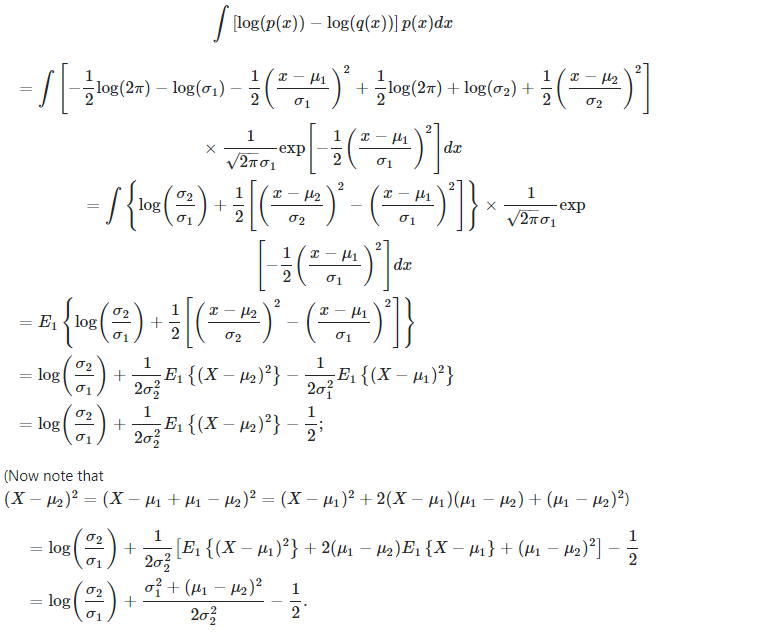


2) From the above:

$D_{KL}\big(N(\mu_1,\sigma_1^2)||N(\mu_2,\sigma_2^2)\big) = \frac{1}{2}\bigg[\log\frac{\sigma_2^2}{\sigma_1^2} + \frac{\sigma_1^2 + (\mu_1 - \mu_2)^2}{\sigma_2^2} - 1\bigg]$

Substituting $\mu_1 = \mu_q$, $\sigma_1^2 = \sigma_q^2$, $\mu_2 = 0$, and $\sigma_2^2 = 1$ into this expression gives:

$D_{KL}\big(q(z|x_i)||P(z)\big) = \frac{1}{2}\bigg[-\log\sigma_{q}^2 + \frac{\sigma_{q}^2 + \mu_q^2}{1} - 1\bigg]$

Thus:

$-D_{KL}\big(q(z|x_i)||P(z)\big) = \frac{1}{2}\bigg[1 + \log(\sigma_{q}^2) - \sigma_{q}^2 - \mu_q^2\bigg]$


**Minimizing** the loss function, over a batch in the dataset now can be written as:

$\mathcal{L(\theta,\phi)} = -\sum_j^J\bigg(\frac{1}{2}\big[1+\log(\sigma_{q_j}^2)-\sigma_{q_j}^2-\mu_{q_j}^2\big]\bigg) - \frac{1}{M}\sum_i^M\bigg(E_{~q_{\theta}(z|x_i)}\big[\log\big(P_{\phi}(x_i|z)\big)\big]\bigg)$

where $J$ is the dimension of the latent vector $z$ and $M$ is the number of samples stochastically drawn from the dataset.

# **Question 4. VAE Implementation (25 %)**

As seen in class, a suitable way to extract features from dataset of images is by convolutional neural network (CNN). Hence, here you will build a convolutional VAE.
\
The basic idea is to start from full resolution images, and by convolutional kernels extract the important features of the dataset. Remember that the output of the VAE should be in the same dimensions $(H_1,W_1,C_1)$ as the input images. 

**The encoder** should be comprised of convolutional layers (nn.Conv2d). Recall that the dimension of the input images is changing according to:

$Z = \bigg(H_2(=\frac{H_1-F+2P}{S}+1),W_2(=\frac{W_1-F+2P}{S}+1),C_2\bigg)$

where $S$ is the stride, $F$ is the kernel size, $P$ is the zero padding and $C_2$ is the selected output channels. $Z$ is the output image.

**The decoder** should reconstruct the images from the latent space. In order to enlarge dimensions of images, your network should be comprised of transposed convolutional layers (nn.ConvTranspose2d). See the following images of the operation of transpose convolution to better understand the way it works.




***Transposed Convolution with Stride = 1***

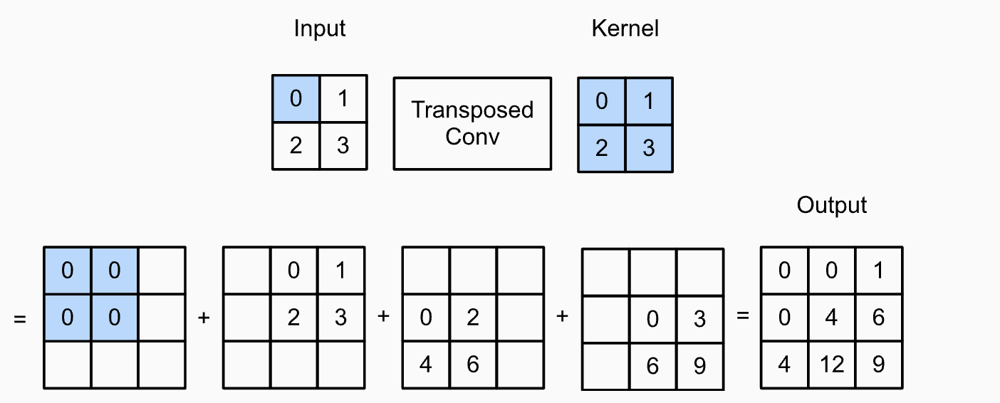

***Transposed Convolution with Stride = 2***
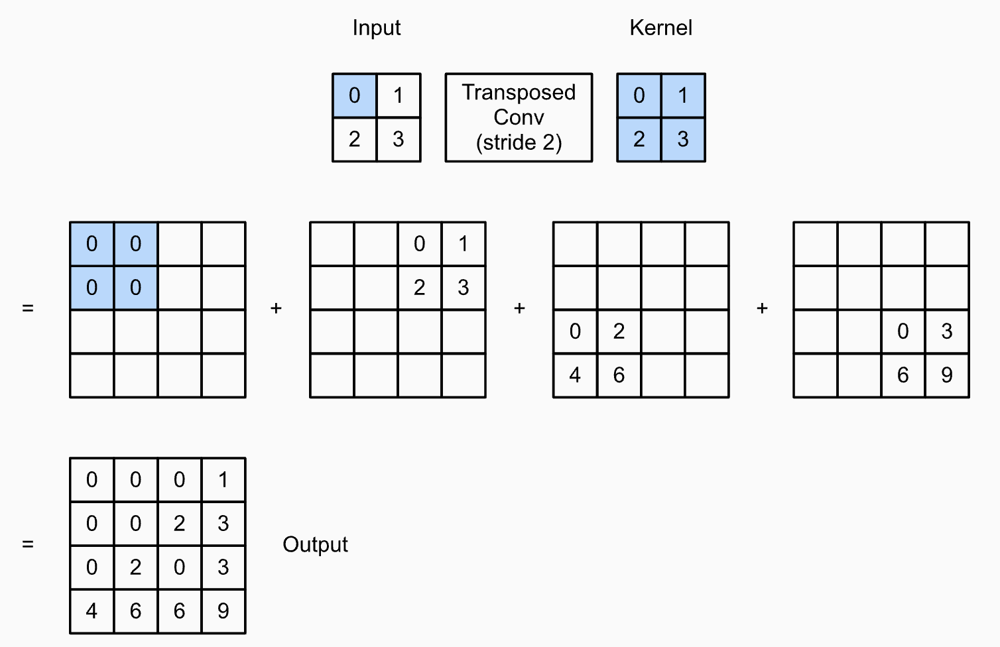

The architecture of your VAE network should be in the following form:


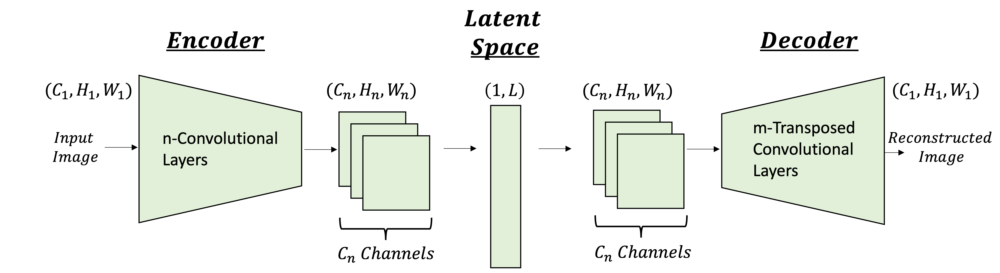

# **Part (a) -- 7%**

 **Encoder**

Here, you will implement the architecture of the encoder. 

The encoder should consist of 4 Blocks as follows:

BLOCK 1: 
- Convolutional layer (nn.Conv2D(in_channels, num_hidden, kernel_size=(3,3), stride=(2,2)))
- Batch Normalization(num_hidden)
- Activation Function: nn.ReLU()

BLOCK 2: 
- Convolutional layer (nn.Conv2D(num_hidden, num_hidden * 2, kernel_size=(3,3), stride=(2,2))
- Batch Normalization(num_hidden * 2)
- Activation Function: nn.ReLU()

BLOCK 3: 
- Convolutional layer (nn.Conv2D(num_hidden * 2, num_hidden * 4, kernel_size=(3,3), stride=(2,2))
- Batch Normalization(num_hidden * 4)
- Activation Function: nn.ReLU()

BLOCK 4: 
- Convolutional layer (nn.Conv2D(num_hidden * 4, num_hidden * 8, kernel_size=(3,3), stride=(2,2))
- Batch Normalization(num_hidden * 8)
- Activation Function: nn.ReLU()

In addidion to the 4 Blocks, you should add the following linear layers:

Linear $\mu$: 
- nn.Linear( ___ ,latent). 

Linear $\log(\sigma)$: 
- nn.Linear( ___ ,latent).

**NOTES:** 

- The input of the linear layer should be according to the size of the images you picked in the transformation part. (If you did resize the images)

- Consider using Padding in the convolutional layers to correct mismatches in sizes.

- In the forward function, you will have to reshape the output from the 4'th block to $(H_4\cdot W_4\cdot C_4 , latent)$, where $H_4$ is the height of the output image from the 4'th block, $W_4$ is the width of the output image from the 4'th block and $C_4$ is num_hidden*8 (number of channels of the output image from the 4'th block).

**You can change any parameter of the network to suit your code - this is only a recommendation.**

In [ ]:
class Encoder(nn.Module):
    def __init__(self, in_channels, num_hiddens, latent):
      super(Encoder, self).__init__()

      self.num_hiddens = num_hiddens
      self.latent = latent
      self.in_channels = in_channels
      self.block1 = nn.Sequential(nn.Conv2d(self.in_channels, self.num_hiddens, kernel_size=3, stride=2),nn.BatchNorm2d(self.num_hiddens),nn.ReLU())
      
      self.block2 = nn.Sequential(nn.Conv2d(self.num_hiddens, self.num_hiddens * 2, kernel_size=3, stride=2),nn.BatchNorm2d(self.num_hiddens * 2),nn.ReLU())

      self.block3 = nn.Sequential(nn.Conv2d(self.num_hiddens * 2, self.num_hiddens * 4, kernel_size=3, stride=2),nn.BatchNorm2d(self.num_hiddens * 4),nn.ReLU())
      
      self.block4 = nn.Sequential(nn.Conv2d(self.num_hiddens * 4, self.num_hiddens * 8, kernel_size=3, stride=2),nn.BatchNorm2d(self.num_hiddens * 8),nn.ReLU())

      self.fc_mu = nn.Linear((self.num_hiddens*8)*12*10,latent)     
      self.fc_logvar = nn.Linear((self.num_hiddens*8)*12*10,latent) 

    def forward(self, x):
        x = self.block1(x)
        x = self.block2(x)
        x = self.block3(x)
        x = self.block4(x)
        x = x.view(x.size(0),-1) # reshape for tensor
        #x = x.reshape(-1, (8*self.num_hiddens)*12*10)
        mu = self.fc_mu(x)
        logvar = self.fc_logvar(x)

        return mu, logvar 

**Notice: We output $\log\sigma$ and not $\sigma^2$, this is a convention when training VAEs but it is completely equivalent.**

# **Part (b) -- 7%**
 **Decoder**

Here, you will implement the architecture of the decoder. 

First, Apply a linear layer to the input of the decoder as follows:

- nn.Linear(latent, ___ ).

The output of the linear layer should match to $H_4\cdot W_4\cdot C_4$, which were the same parameters from the encoder 4'th block's output.

Then, the decoder should consist of 4 Blocks as follows:

BLOCK 1: 
- Transposed Convolutional layer (nn.ConvTranspose2d(in_channels, num_hidden // 2, kernel_size=(4,4), stride=(2,2)))
- Batch Normalization(num_hidden // 2)
- Activation Function: nn.ReLU() or nn.LeakyReLU()

BLOCK 2: 
- Transposed Convolutional layer (nn.ConvTranspose2d(num_hidden // 2, num_hidden // 4, kernel_size=(4,4), stride=(2,2)))
- Batch Normalization(num_hidden // 4)
- Activation Function: nn.ReLU() or nn.LeakyReLU()

BLOCK 3: 
- Transposed Convolutional layer (nn.ConvTranspose2d(num_hidden // 4, num_hidden // 8, kernel_size=(4,4), stride=(2,2)))
- Batch Normalization(num_hidden // 8)
- Activation Function: nn.ReLU() or nn.LeakyReLU()

BLOCK 4: 
- Transposed Convolutional layer (nn.ConvTranspose2d(num_hidden // 8, num_hidden // 8, kernel_size=(4,4), stride=(2,2)))
- Batch Normalization(num_hidden // 8)
- Activation Function: nn.ReLU() or nn.LeakyReLU()


Afterwards, we should generate an image in the same size as our input images. Thus add 1 more block consisting of:

BLOCK 5:
 - nn.Conv2d(num_hiddens//8, out_channels=3,kernel_size=(3,3), stride=(1,1), padding=(1,1)),
 - Activation function.

**NOTES:** 

- The output of the linear layer should be according to the size of the images you picked in the transformation part. (If you did resize the images)

- Consider using Padding in the  transposed convolutional layers to correct mismatches in sizes.

- In the forward function, you will have to reshape the output of the linear layer to ($Batch, H_4, W_4, C_4$)

- The output of the decoder should be of values in $[0,1]$.



**You can change any parameter of the network to suit your code, this is only a recommendation.**

In [ ]:
class Decoder(nn.Module):
    def __init__(self, in_channels, num_hiddens,latent):
        super(Decoder, self).__init__()
        self.in_channels = in_channels
        self.activation = nn.LeakyReLU() # or nn.LeakyReLU()
        self.num_hiddens = num_hiddens

        self.fc_dec = nn.Linear(latent,in_channels*12*10) # need to be in same dimention as before the FC NN (here it is still a row vector)

        self.block1 = nn.Sequential(nn.ConvTranspose2d(self.in_channels, self.num_hiddens // 2, kernel_size=4, stride=2),nn.BatchNorm2d(self.num_hiddens // 2),self.activation)
        
        self.block2 = nn.Sequential(nn.ConvTranspose2d(self.num_hiddens // 2, self.num_hiddens // 4, kernel_size=4, stride=2),nn.BatchNorm2d(self.num_hiddens // 4),self.activation)

        self.block3 = nn.Sequential(nn.ConvTranspose2d(self.num_hiddens // 4, self.num_hiddens // 8, kernel_size=4, stride=2),nn.BatchNorm2d(self.num_hiddens // 8),self.activation)
        
        self.block4 = nn.Sequential(nn.ConvTranspose2d(self.num_hiddens // 8, self.num_hiddens // 8, kernel_size=4, stride=2 , padding = (2,6)),nn.BatchNorm2d(self.num_hiddens // 8),self.activation)

        self.block5 = nn.Sequential(nn.Conv2d(self.num_hiddens // 8, out_channels=3, kernel_size=3, stride=1,padding=1),nn.Sigmoid()) 


    def forward(self, x):
        x = self.fc_dec(x)
        x = x.reshape(-1, self.in_channels, 12, 10) # try to add [0,:,:,:] if not working
        x = self.block1(x)
        x = self.block2(x)
        x = self.block3(x)
        x = self.block4(x)
        x = self.block5(x)
        #x = nnF.normalize(x)
        x_rec = x
        
        return x_rec

### Part (c) -- 4% 
**VAE Model**

Once you have the architecture of the encoder and the decoder, we want to put them together and train the network end-to-end.

Remember that in VAEs, you need to sample from a gaussian distribution at the input of the decoder. In order to backpropagate through the network, we use the reparametrization trick. The reparametrization trick is saying that sampling from $𝑧∼N(\mu,\sigma)$ is equivalent to sampling $\varepsilon∼N(0,1)$ and setting $𝑧=\mu+\sigma⊙\varepsilon$. Where, epsilon is an input to the network while keeping your sampling operation differentiable.
The reparametrization function is given to you in the VAE class.

Here, you should write the *forward()* function and to combine all the model's settings to a final network.

In [ ]:
class VAE(nn.Module):
    def __init__(self, enc_in_chnl,enc_num_hidden,dec_in_chnl,dec_num_hidden,latent):
      super(VAE, self).__init__()
      self.encode = Encoder(in_channels=enc_in_chnl, num_hiddens=enc_num_hidden,latent = latent)
      self.decode = Decoder(in_channels=dec_in_chnl, num_hiddens=dec_num_hidden,latent = latent)

    # Reparametrization Trick
    def reparametrize(self, mu, logvar):
      std = torch.exp(0.5 * logvar)
      eps = torch.randn_like(std)     
      return eps.mul(std).add_(mu)

    # Initialize Weights
    def weight_init(self, mean, std):
      for m in self._modules:
        if isinstance(m, nn.ConvTranspose2d) or isinstance(m, nn.Conv2d):
          m.weight.data.normal_(mean, std)
          m.bias.data.zero_()

    def forward(self, x):
      mu, logvar = self.encode(x)
      z = self.reparametrize(mu, logvar)
      x_rec = self.decode(z)
      return x_rec , mu, logvar

### Part (d) -- 7% 

**Loss Function**

As we saw earlier, the loss function is based on the ELBO; Over a batch in the dataset, it can be written as:

$\mathcal{L(\theta,\phi)} = -\sum_j^J\bigg(\frac{1}{2}\big[1+\log(\sigma_{q_j}^2)-\sigma_{q_j}^2-\mu_{q_j}^2\big]\bigg) - \frac{1}{M}\sum_i^M\bigg(E_{~q_{\theta}(z|x_i)}\big[\log\big(P_{\phi}(x_i|z)\big)\big]\bigg)$

where $J$ is the dimension of the latent vector $z$ and $M$ is the number of samples stochastically drawn from the dataset.

**$\beta$-Variational Autoencoder ($\beta$-VAE)**

As seen in class, the fact that the ELBO is comprised of the sum of two loss terms implies that these can be balanced using an additional hyperparameter $\beta$, i.e.,

$\beta\cdot D_{KL}\big(q(z|x_i)||P(z)\big) - E_{~q(z|x_i)}\big[\log\big(P(x_i|z)\big)\big]$

It is highly recommended to use the $\beta$-loss for increasing performance. 
 


Explain what could be the purpose of the hyperparameter $\beta$ in the loss function? If $\beta = 1$ is same as VAE, What is the effect of $\beta \neq 1$?

## **Answer**

As we explain in one of the previous sections, each part of the ELBO is more significant for a specific "task".

1) $D_{KL}(q_{θ}(z|y)||p_{ϕ}(z))$ captures the **similarity** between the learned probabilistic encoder and the desired marginal of the latent.

2) $−Ez_{∼q_{θ}(z|y)}{log p_{ϕ}(y|z)}$ describes the **accuracy** of the decoder in matching the input distribution

We can guess that the purpose of the hyperparameter β in the β-VAE loss function is to balance these two terms. 

For example, if ${β>1}$, the KL divergence term is given more weight, which can help to encourage the model to learn a more complex latent space. On the other hand, if ${β<1}$, the decoder accuracy term is given more weight, which can help to improve the reconstruction quality of the model.

To summeries this up, the ${β}$ parameter allows us to fine-tune the trade-off between the ELBO parts according to our need.


Here you should write specifically the code for the loss function.


## **Note**

While we computed the loss, please note that we used logvar.exp() in order to extract the **variance** from the log operation (because our input is logvar). 

In addition, we would just like to emphasize that the letter σ represents the standard deviation, which is the **square root** of the variance, thus the term "var" in opur code syntax is already reffered to the notation of ${σ^2}$

In [ ]:
def vae_loss(x_recon, x, mu, logvar, beta=0.1):
    mse = nn.MSELoss(reduction='sum')
    # reconstruction loss (Binary Cross Entropy)
    BCE = nnF.binary_cross_entropy(x_recon, x, reduction='sum')
    MSE = mse(x_recon, x)/(len(x_recon))
    #BCE = 1
    # KL divergence loss
    KLD = -0.5 * torch.sum(1 + logvar - logvar.exp() - mu.pow(2) ,dim=-1).mean(dim=0) #KL Divergence
    
    return MSE , BCE, KLD*beta

 Here, define all the hyperparameters values for the training process. 

We gave you recommended values for the VAE model. You can modify and change it to suit your code better if needed.

In [ ]:
learning_rate = 0.0001
batch_size = 200
num_epochs = 25
dataset_size = 30000 # How many data samples to use for training, 30,000 should be enough.

#VAE Class inputs: 
enc_in_chnl = 3 # the initial channel number before we proccessed any data
enc_num_hidden = 32 # number of "features" we would like to extract at the first encoder block and so on...
dec_in_chnl = enc_num_hidden*8 # in order to fit to the output channel of the encoder in its last block
dec_num_hidden = 256 # arbitrary

In [ ]:
train_loader = torch.utils.data.DataLoader(training_data, batch_size=batch_size, shuffle=True) 
test_loader = torch.utils.data.DataLoader(test_data, batch_size=batch_size, shuffle=True) 

# **Question 5. VAE Training (15 %)**



# **Part (a) -- 4%** 
Complete the training function below

In [ ]:
def train(model,batch_size,num_epochs=50, learning_rate=1e-4 ,dataset_size = 30000 , valset_size =2000, checkpoint_path = None,
          loss_func = 'MSE'):

  # Define optimizer
  optimizer = torch.optim.Adam(model.parameters() , lr =learning_rate )

  # Initialize output lists
  train_loss_lst = []
  test_loss_lst = []
  val_iters = []
  train_iters = []
  # Move model to GPU
  model.to(device)
  n = 0
  iter_train = 0
  iter_val = 0
  for epoch in range(num_epochs):
        n+=1
        # Train step
        

        # Set model to training mode 
        model.train()
        #for y, _ in train_loader:
        for batch_idx, batch in enumerate(train_loader):
          train_loss = 0
          imgs, _ = batch
          #imgs = imgs[torch.randperm(batch_size)]
          imgs = imgs.to(device) # At the beggining it was img.cuda()
              
          # Forward pass
          x_recon, mu, logvar = model(imgs)
          
          MSE , BCE, KLD = vae_loss(x_recon, imgs, mu, logvar)
          if loss_func == "MSE":
            loss = MSE + KLD
          else:
            loss = BCE + KLD
          train_loss += loss.item() 

          # Backpropagation
          optimizer.zero_grad()
          loss.backward()
          optimizer.step()

          train_iters.append(iter_train)
          iter_train +=1
        # Since the dataset is large, train on 'dataset_size' samples.
          if dataset_size//batch_size == batch_idx:
            break

          if batch_idx % 100 ==0:
            train_loss_lst.append(train_loss) 
            print(f'Epoch {epoch} - Batch {batch_idx}, Training Loss: {train_loss/dataset_size:.4f}')


        # Val step

        with torch.no_grad():

          # Set model to evaluate mode 
          model.eval()
          val_loss = 0
          batch_idx =0
          for batch_idx, batch in enumerate(test_loader):
          #for batch_idx, batch in enumerate(test_loader):
            imgs, _ = batch
            imgs = imgs.to(device)
            
            # Forward pass
            x_recon, mu, logvar = model(imgs)
            MSE , BCE, KLD = vae_loss(x_recon, imgs, mu, logvar)
            if loss_func == "MSE":
              loss = MSE + KLD
            else:
              loss = BCE + KLD
            val_loss += loss.item()
            batch_idx+=1
            # Since the dataset is large, train on 'dataset_size' samples.
            if valset_size//batch_size == batch_idx:
              break

          val_iters.append(iter_val)
          iter_val +=1
          test_loss_lst.append(val_loss) 
          print(f'Epoch {epoch}, Test Loss: {val_loss/(valset_size):.4f}')
          
        image1 = imgs.cpu().numpy()[0]
        recon = x_recon.detach().cpu().numpy()[0]
        show([image1,recon],1,2)
        torch.save(model.state_dict(), checkpoint_path.format(n))
  # move model to cpu when finishing ephocs loop
  model = model.to('cpu')   
  return train_loss_lst, train_iters , test_loss_lst , val_iters

### Part (b) -- 4%  

We first train with dimension of latent space $L=3$

We recommend to use *weight_init()* function, which helps stabilize the training process. 

In [ ]:
latent1 = 3

if torch.cuda.is_available():
    model_1 = VAE(enc_in_chnl,enc_num_hidden,dec_in_chnl,dec_num_hidden,latent1).cuda()
    model_1.weight_init(mean=0, std=0.02)
else:
    model_1 = VAE(enc_in_chnl,enc_num_hidden,dec_in_chnl,dec_num_hidden,latent1)
    model_1.weight_init(mean=0, std=0.02)


Train your model, plot the train and the validation loss graphs. Explain what is seen.

Epoch 0 - Batch 0, Training Loss: 0.3943
Epoch 0 - Batch 100, Training Loss: 0.1791
Epoch 0 - Batch 200, Training Loss: 0.1705
Epoch 0, Test Loss: 48.6795


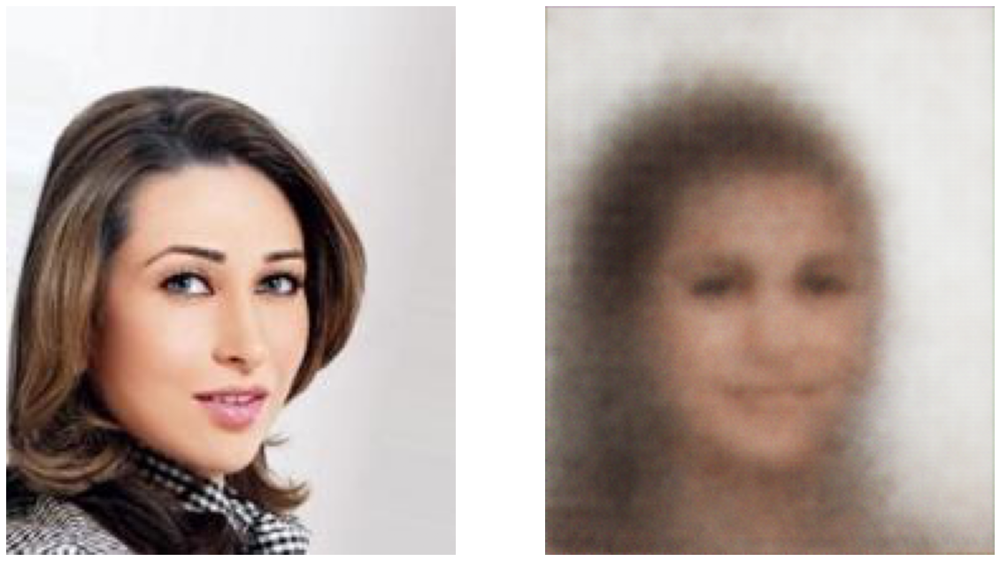

Epoch 1 - Batch 0, Training Loss: 0.1625
Epoch 1 - Batch 100, Training Loss: 0.1623
Epoch 1 - Batch 200, Training Loss: 0.1642
Epoch 1, Test Loss: 48.3410


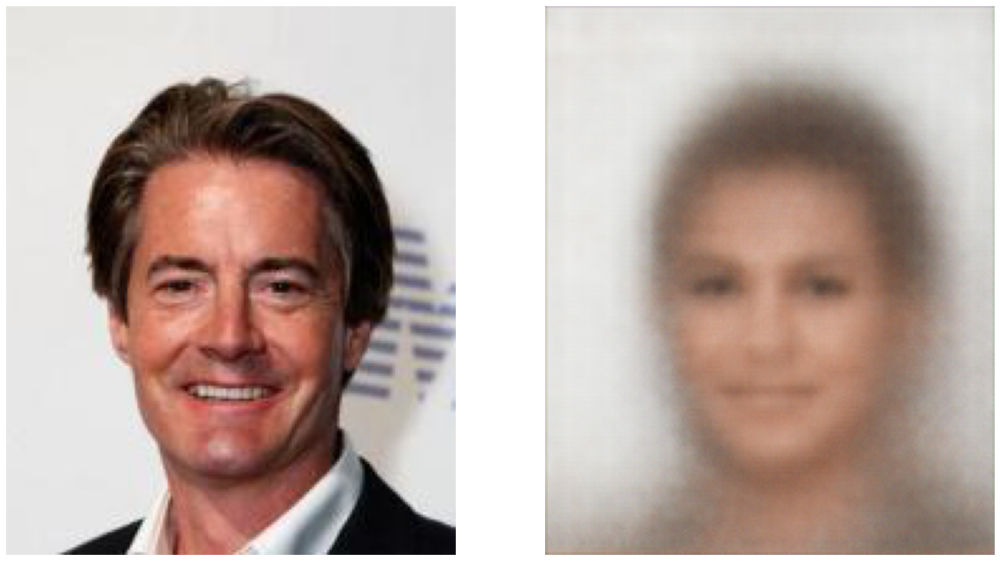

Epoch 2 - Batch 0, Training Loss: 0.1630
Epoch 2 - Batch 100, Training Loss: 0.1619
Epoch 2 - Batch 200, Training Loss: 0.1556
Epoch 2, Test Loss: 47.3837


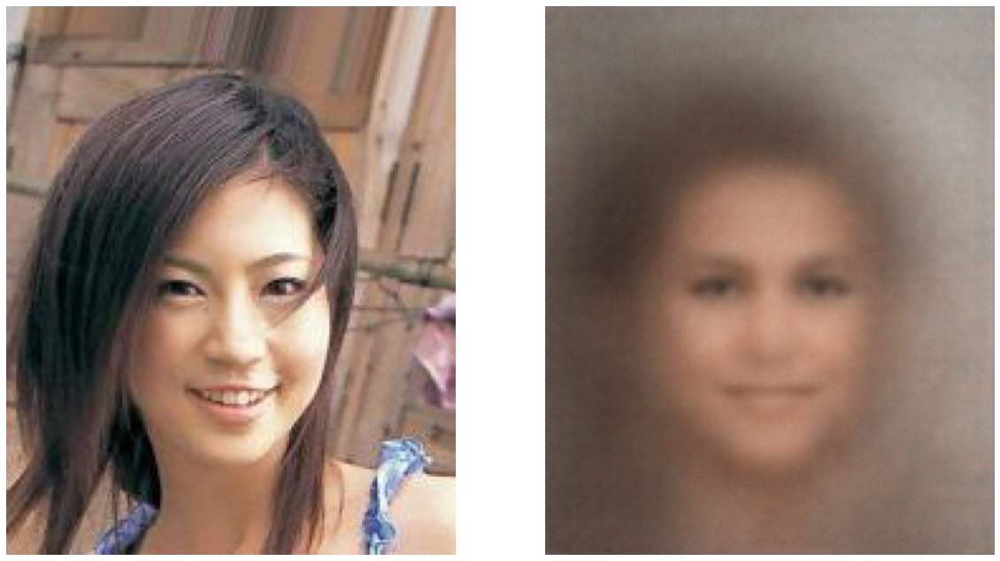

Epoch 3 - Batch 0, Training Loss: 0.1561
Epoch 3 - Batch 100, Training Loss: 0.1635
Epoch 3 - Batch 200, Training Loss: 0.1580
Epoch 3, Test Loss: 48.2355


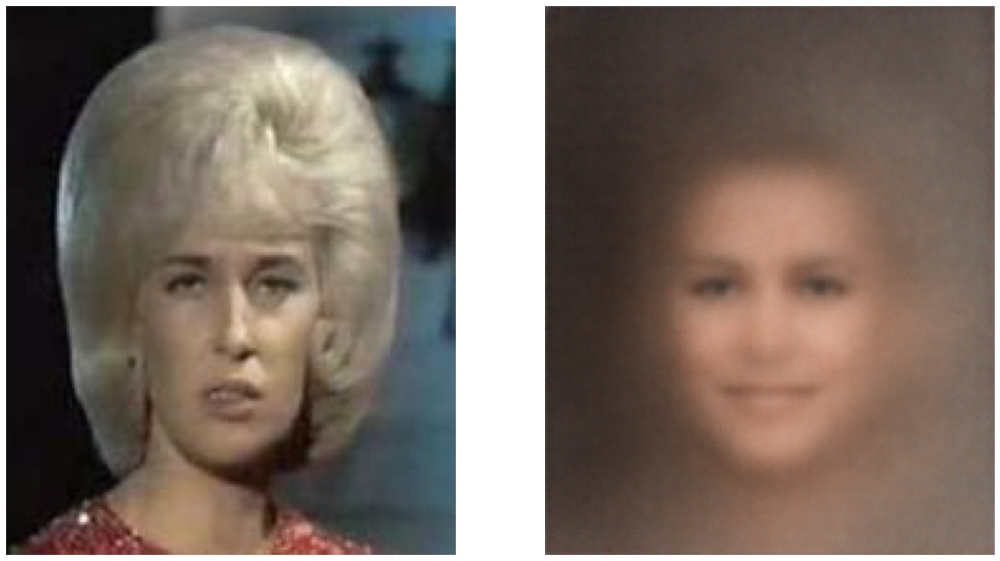

Epoch 4 - Batch 0, Training Loss: 0.1729
Epoch 4 - Batch 100, Training Loss: 0.1675
Epoch 4 - Batch 200, Training Loss: 0.1689
Epoch 4, Test Loss: 47.4014


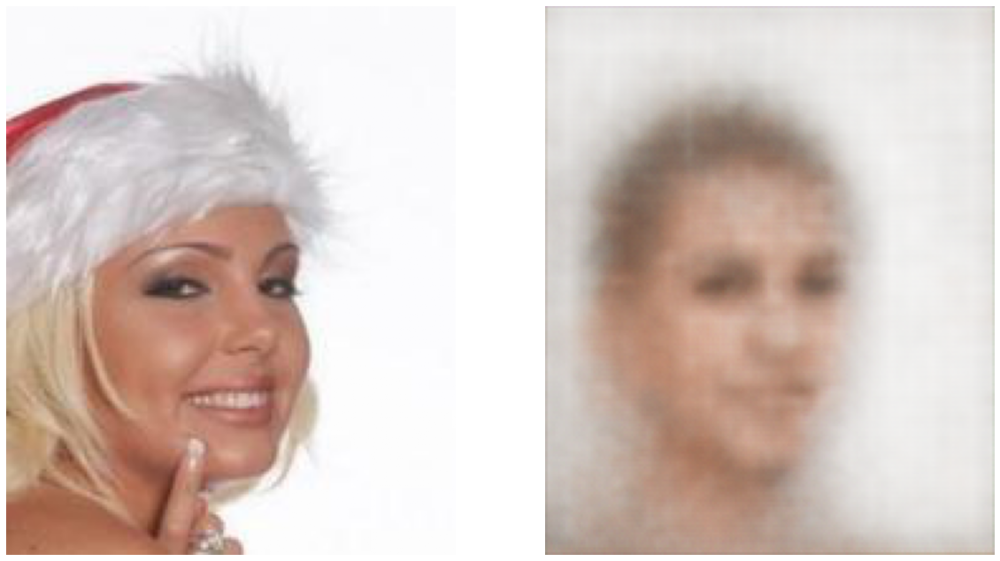

Epoch 5 - Batch 0, Training Loss: 0.1578
Epoch 5 - Batch 100, Training Loss: 0.1583
Epoch 5 - Batch 200, Training Loss: 0.1652
Epoch 5, Test Loss: 47.7334


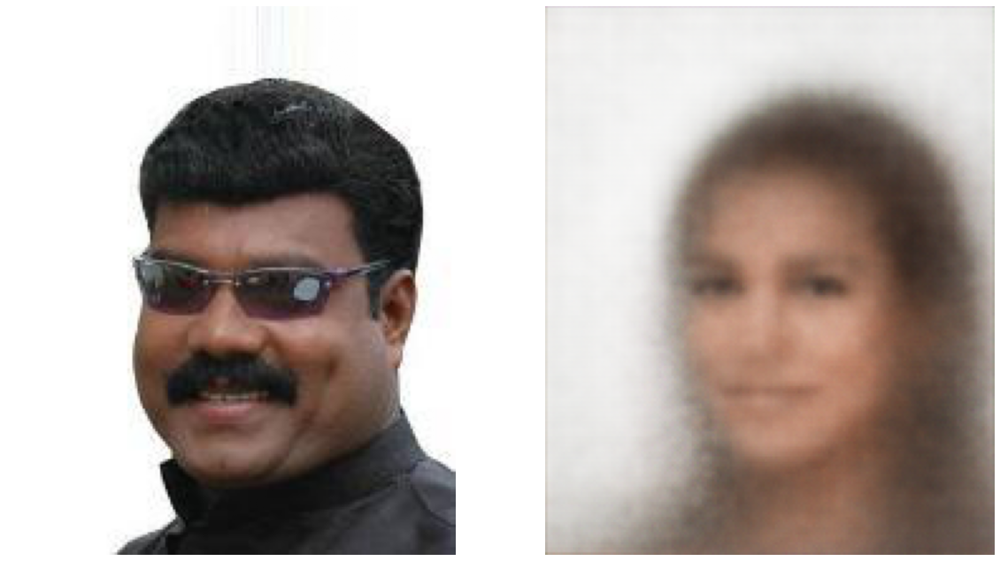

Epoch 6 - Batch 0, Training Loss: 0.1594
Epoch 6 - Batch 100, Training Loss: 0.1574
Epoch 6 - Batch 200, Training Loss: 0.1669
Epoch 6, Test Loss: 47.5478


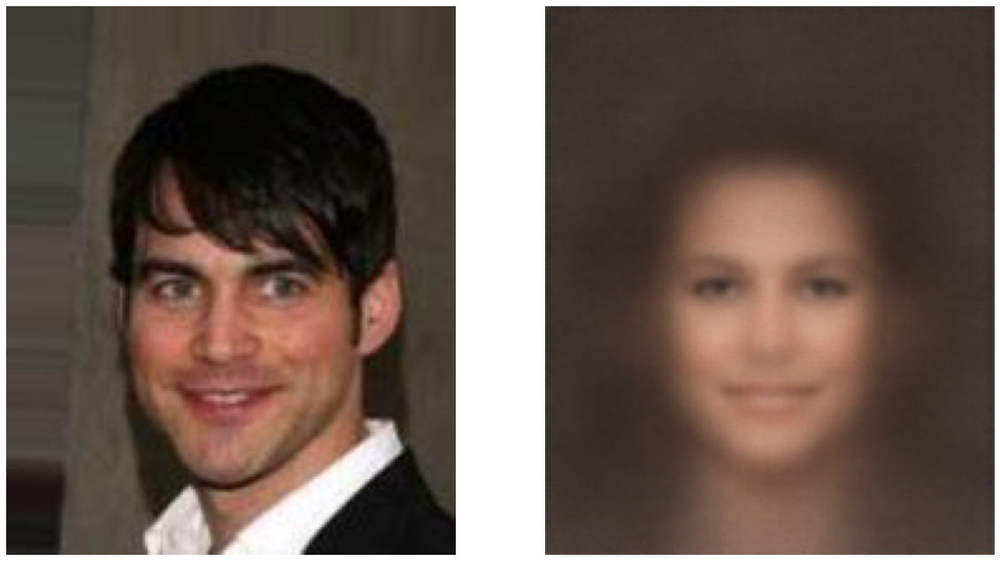

Epoch 7 - Batch 0, Training Loss: 0.1629
Epoch 7 - Batch 100, Training Loss: 0.1575
Epoch 7 - Batch 200, Training Loss: 0.1591
Epoch 7, Test Loss: 47.3195


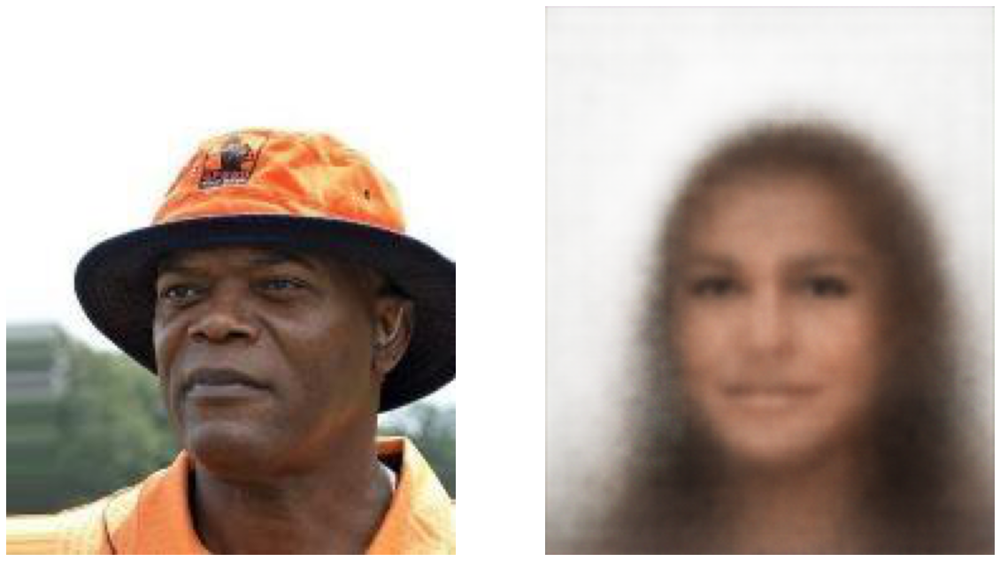

Epoch 8 - Batch 0, Training Loss: 0.1578
Epoch 8 - Batch 100, Training Loss: 0.1539
Epoch 8 - Batch 200, Training Loss: 0.1578
Epoch 8, Test Loss: 47.5158


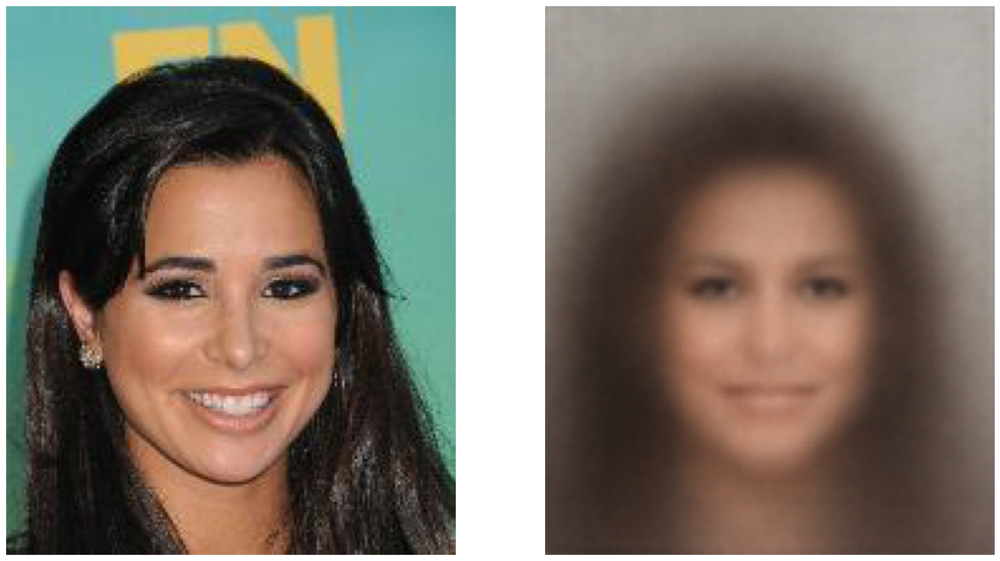

Epoch 9 - Batch 0, Training Loss: 0.1526
Epoch 9 - Batch 100, Training Loss: 0.1565
Epoch 9 - Batch 200, Training Loss: 0.1675
Epoch 9, Test Loss: 46.8119


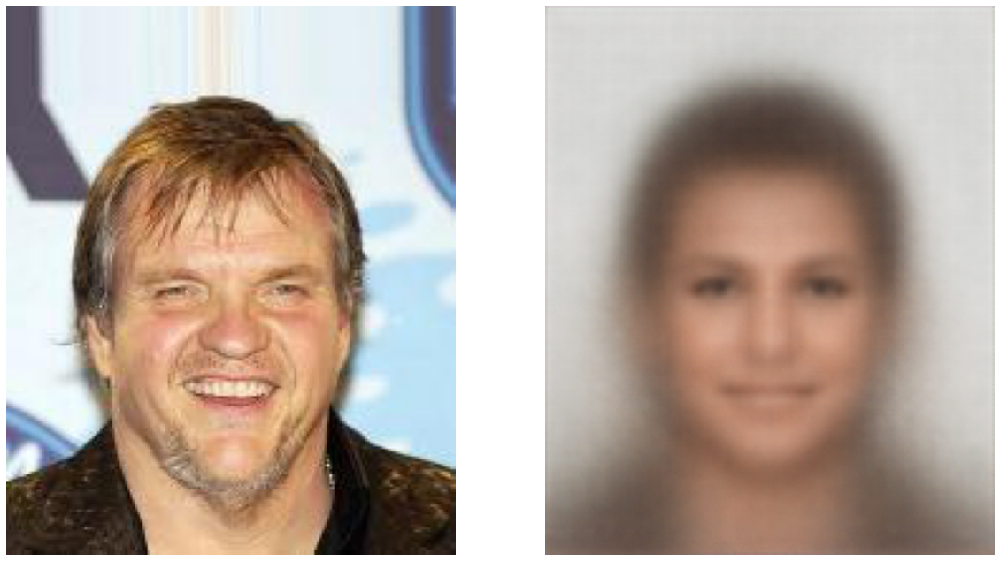

Epoch 10 - Batch 0, Training Loss: 0.1608
Epoch 10 - Batch 100, Training Loss: 0.1607
Epoch 10 - Batch 200, Training Loss: 0.1621
Epoch 10, Test Loss: 47.2067


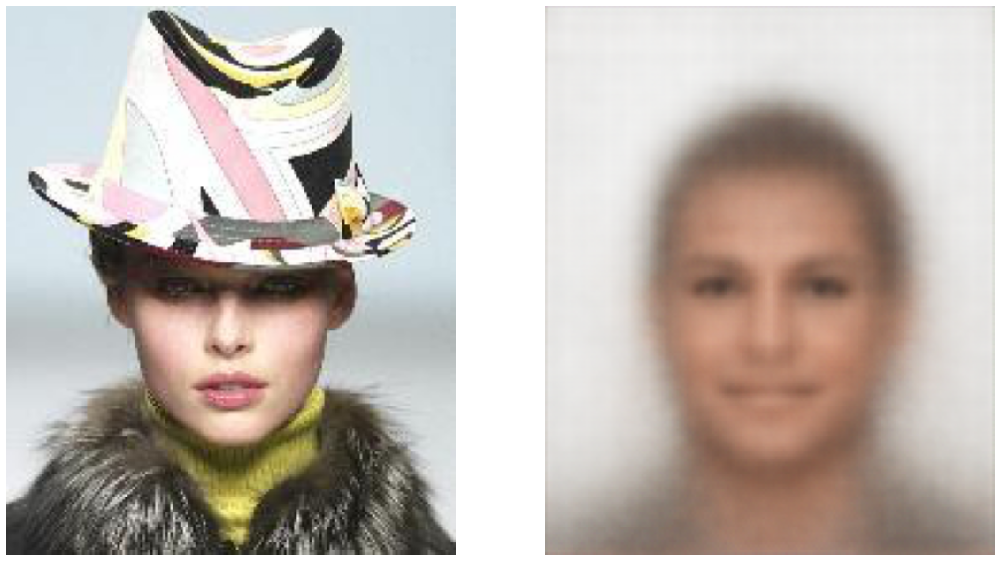

Epoch 11 - Batch 0, Training Loss: 0.1605
Epoch 11 - Batch 100, Training Loss: 0.1558
Epoch 11 - Batch 200, Training Loss: 0.1608
Epoch 11, Test Loss: 47.6018


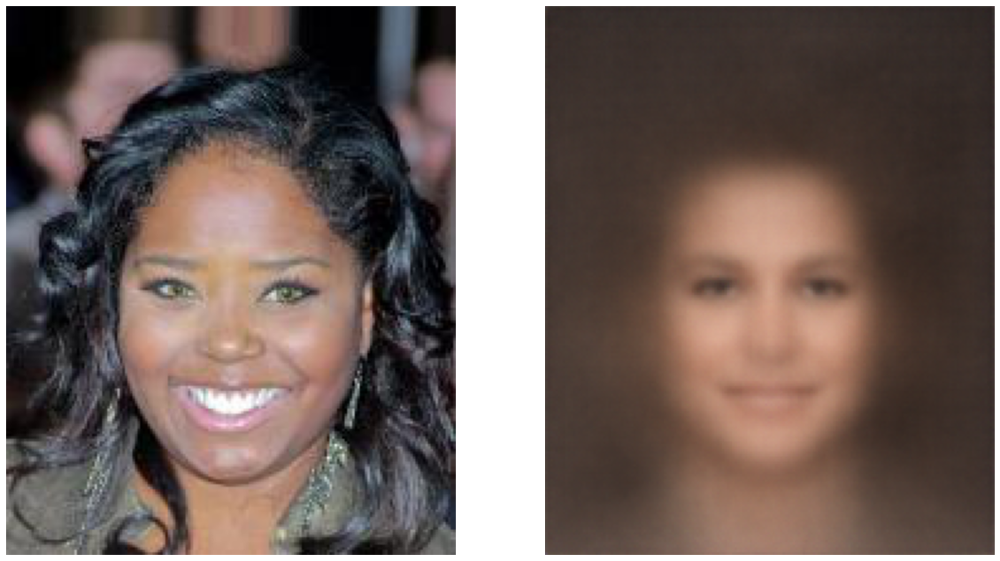

Epoch 12 - Batch 0, Training Loss: 0.1570
Epoch 12 - Batch 100, Training Loss: 0.1535
Epoch 12 - Batch 200, Training Loss: 0.1586
Epoch 12, Test Loss: 46.8835


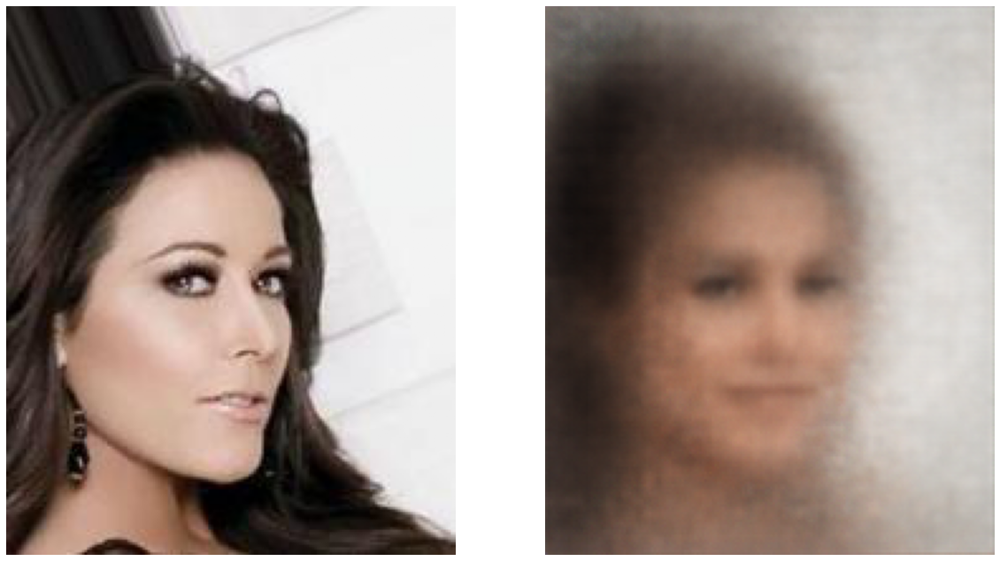

Epoch 13 - Batch 0, Training Loss: 0.1553
Epoch 13 - Batch 100, Training Loss: 0.1577
Epoch 13 - Batch 200, Training Loss: 0.1529
Epoch 13, Test Loss: 47.7421


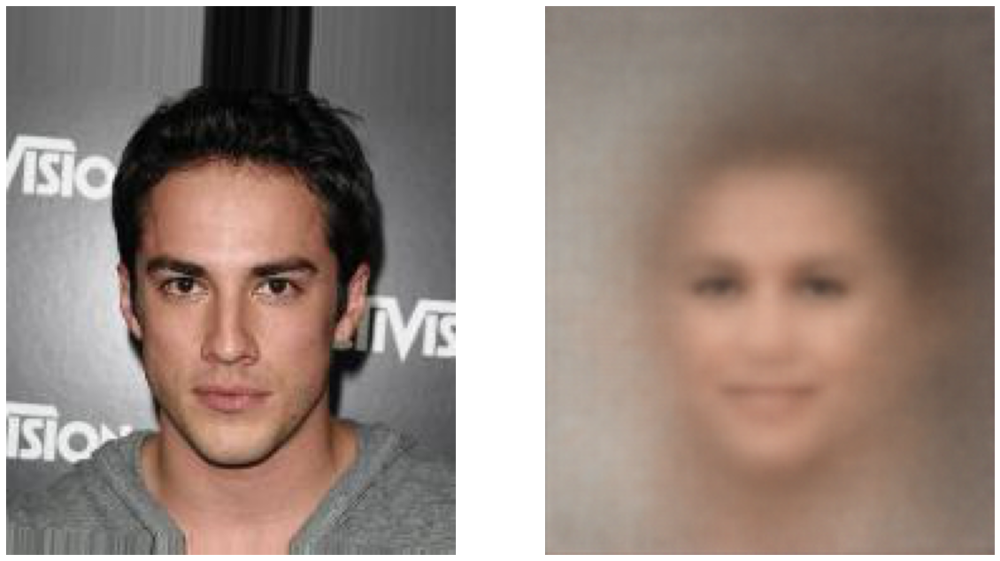

Epoch 14 - Batch 0, Training Loss: 0.1613
Epoch 14 - Batch 100, Training Loss: 0.1431
Epoch 14 - Batch 200, Training Loss: 0.1511
Epoch 14, Test Loss: 46.8923


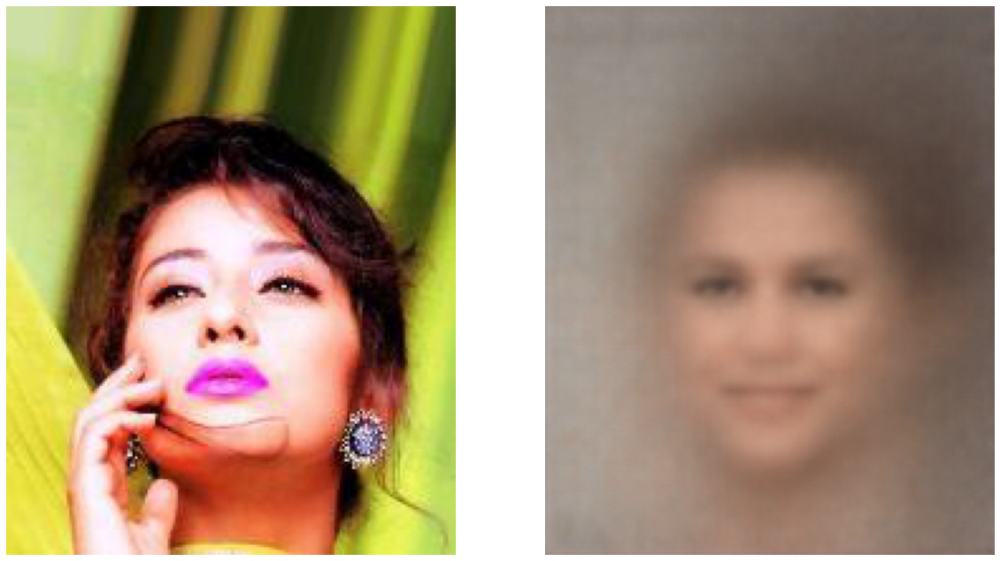

In [ ]:
train_loss_lst1, train_iters1 , test_loss_lst1 , val_iters1 =train(model_1 , num_epochs=15,batch_size = 100 , 
                                                                   checkpoint_path='/content/gdrive/MyDrive/DP_course/ex4/checkpoints1/ckpt-{}.pk')

In [ ]:
train_loss_lst11 = np.array(train_loss_lst1)
np.save('/content/gdrive/MyDrive/DP_course/ex4/checkpoints1/train_loss_lst1' ,train_loss_lst11 )
test_loss_lst11 = np.array(test_loss_lst1)
np.save('/content/gdrive/MyDrive/DP_course/ex4/checkpoints1/test_loss_lst1' ,test_loss_lst11 )

In [ ]:
def plot_learning_curve(train_iters, train_loss_lst, val_iters, test_loss_lst ):
    """
    Plot the learning curve.
    """
    plt.title("Learning Curve: Loss per Iteration")
    plt.plot(train_iters, train_loss_lst, label="Train")
    plt.xlabel("Iterations")
    plt.ylabel("Loss")
    plt.show()

    plt.title("Validation Curve: Loss per 100 Iteration")
    plt.plot(val_iters, test_loss_lst, label="Validation")
    plt.xlabel("Iterations")
    plt.ylabel("Loss")
    plt.show()



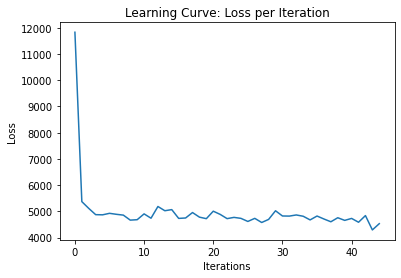

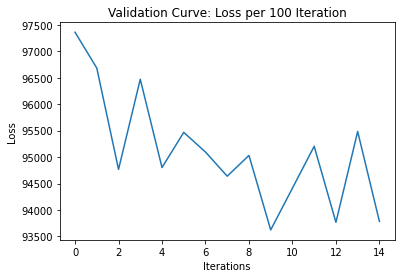

In [ ]:
plot_learning_curve( [x for x in range(45)], train_loss_lst1, [x for x in range(15)],test_loss_lst1 )

We can see that the learning curve changed drammaticly in the first iterations of the training but very soon the loss stopped decreasing.
As you can see we also printed a reconstructed sample each epoch and we can see the training output almost didn't progress over the epochs.


Visualize, from the test dataset, an original image against a reconstructed image. Has the model reconstructed the image successfully? Explain.

In [ ]:
latent1 = 3
model_1 = VAE(enc_in_chnl,enc_num_hidden,dec_in_chnl,dec_num_hidden,latent1)
model_1.to(device)
model_1.load_state_dict(torch.load('/content/gdrive/MyDrive/DP_course/ex4/checkpoints1/ckpt-15.pk'))

<All keys matched successfully>

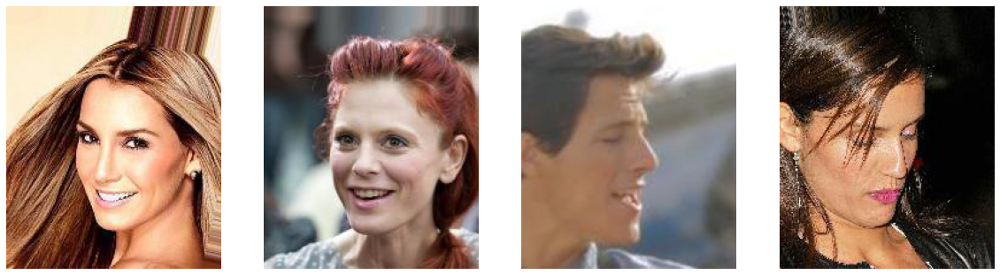

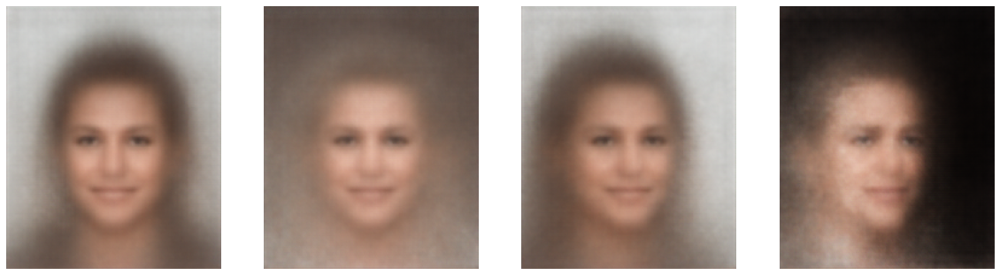

In [ ]:
dataloader = torch.utils.data.DataLoader(training_data, batch_size=4, shuffle=False)

lst_img = []
lst_recon_img = []
n = 0
# Store 4 images in lst_img
for y, _ in (dataloader):
  img = y.to(device)
  recon_img, mu, logvar = model_1(img)
  while n<4:
      # Convert the image tensor to a NumPy array
    image = y.cpu().numpy()[n]
    image = image.swapaxes(0,2).swapaxes(0,1)
    lst_img.append(image)
    
    
    
    # Convert the image tensor to a NumPy array
    
    recon_img_n = recon_img.cpu().detach()[n]

    #recon_img = recon_img.cpu().numpy()[0]
    recon_img_n = recon_img_n.swapaxes(0,2).swapaxes(0,1)
    lst_recon_img.append(recon_img_n)
    n+=1
  break


# Display the image using the imshow function
show(lst_img,1,4)
show(lst_recon_img,1,4)


**Answer:**

We reconstructed 4 different images. As we can see the reconstruction is blurry and almost all the faces look the same but we also can see that the location of each face in the reconstrion is at the correct location and the background is also changing according to the original image. 

The reason we got this reconstrions is because the latent space is very small and in the end of the encoder only 3 features remain. In our opinion this is quite an accomplishment for such a small latent space.

### Part (c) -- 7%  

Next, we train with larger $L > 3$

Based on the results for $L = 3$, choose a larger $L$ to improve your results.
Train new model with your choice for $L$.

In [ ]:
torch.cuda.empty_cache()

Epoch 0 - Batch 0, Training Loss: 0.3884
Epoch 0 - Batch 100, Training Loss: 0.1018
Epoch 0 - Batch 200, Training Loss: 0.0791
Epoch 0, Test Loss: 21.6421


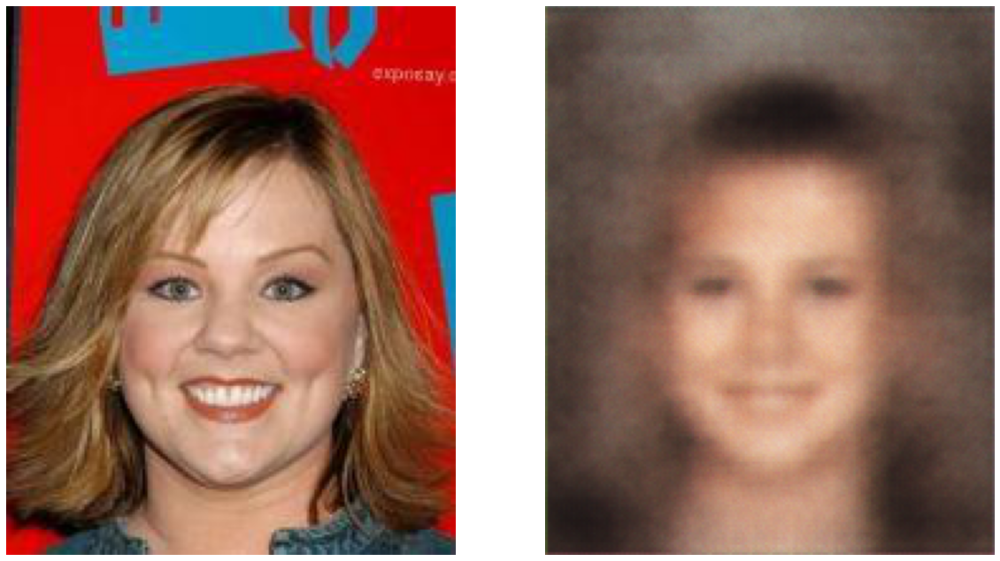

Epoch 1 - Batch 0, Training Loss: 0.0691
Epoch 1 - Batch 100, Training Loss: 0.0659
Epoch 1 - Batch 200, Training Loss: 0.0661
Epoch 1, Test Loss: 17.8012


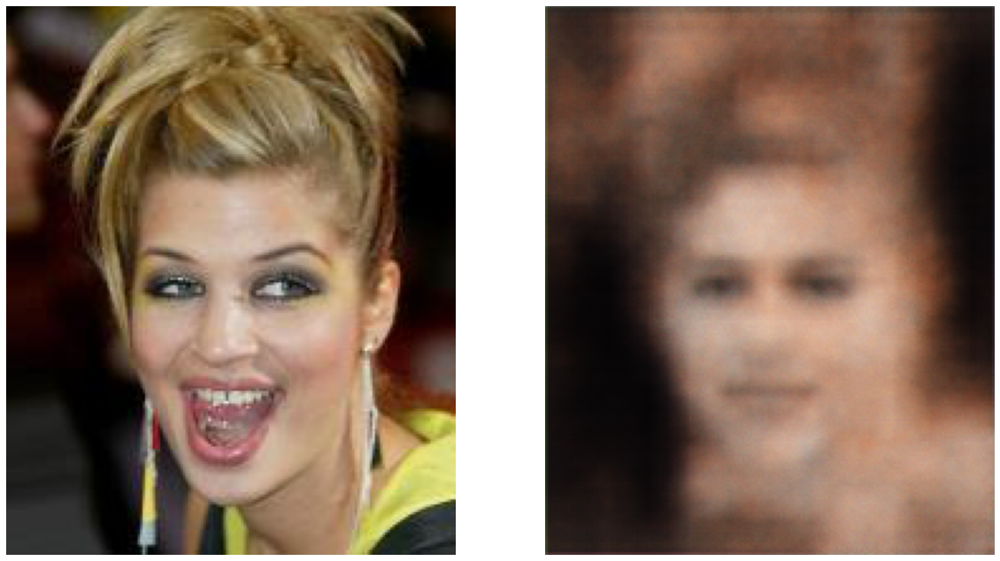

Epoch 2 - Batch 0, Training Loss: 0.0596
Epoch 2 - Batch 100, Training Loss: 0.0561
Epoch 2 - Batch 200, Training Loss: 0.0578
Epoch 2, Test Loss: 16.6485


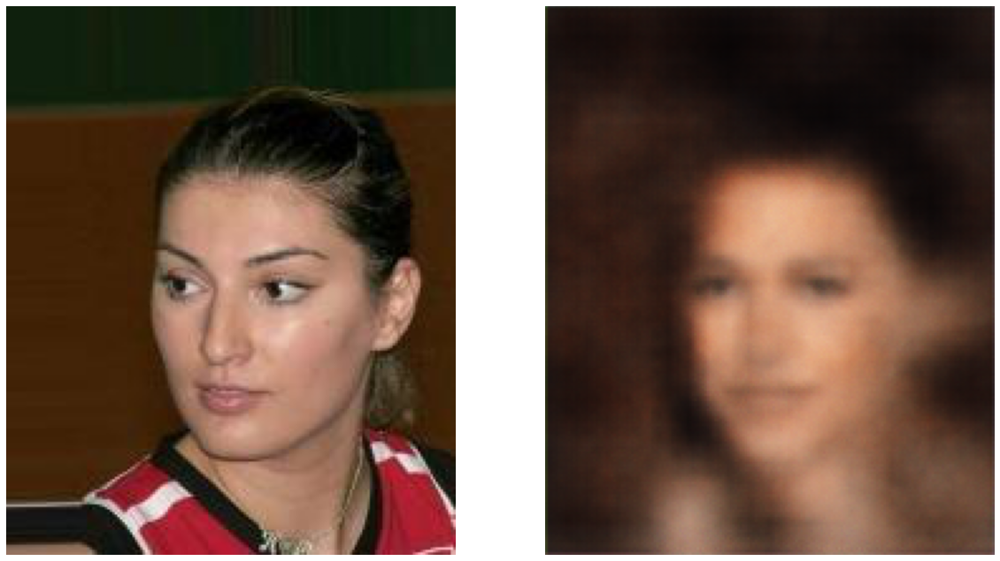

Epoch 3 - Batch 0, Training Loss: 0.0581
Epoch 3 - Batch 100, Training Loss: 0.0546
Epoch 3 - Batch 200, Training Loss: 0.0534
Epoch 3, Test Loss: 16.5720


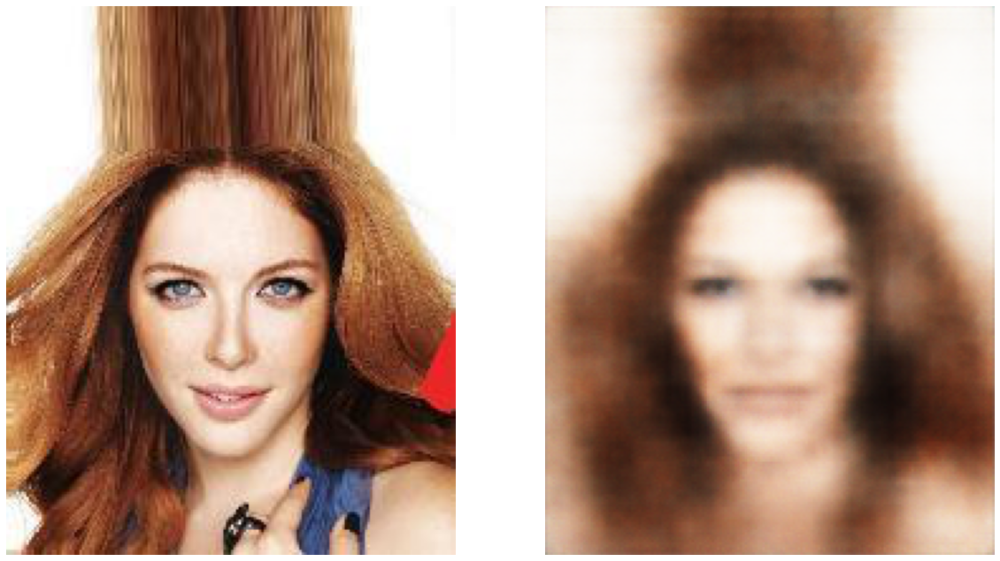

Epoch 4 - Batch 0, Training Loss: 0.0549
Epoch 4 - Batch 100, Training Loss: 0.0512
Epoch 4 - Batch 200, Training Loss: 0.0525
Epoch 4, Test Loss: 15.7265


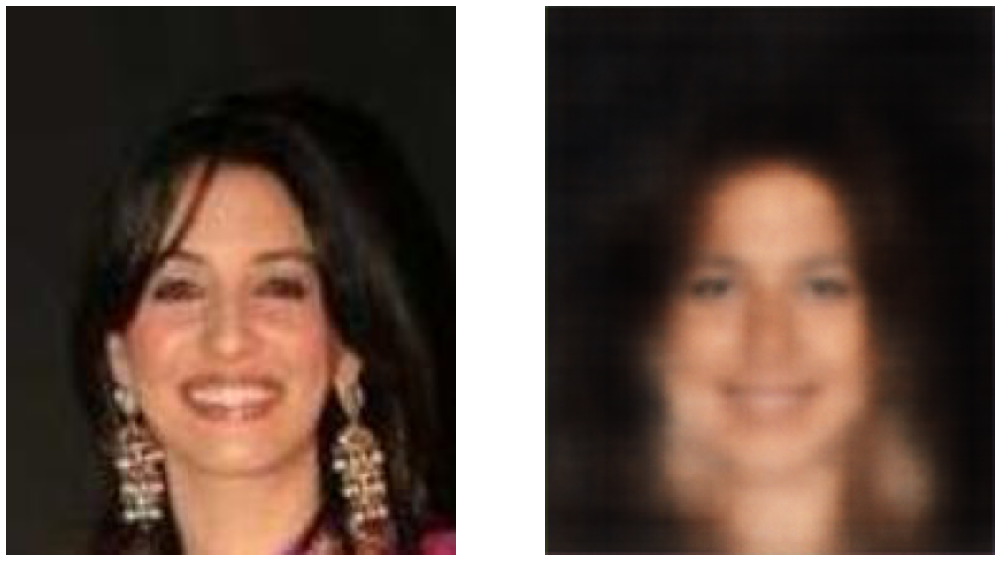

Epoch 5 - Batch 0, Training Loss: 0.0534
Epoch 5 - Batch 100, Training Loss: 0.0519
Epoch 5 - Batch 200, Training Loss: 0.0525
Epoch 5, Test Loss: 15.5593


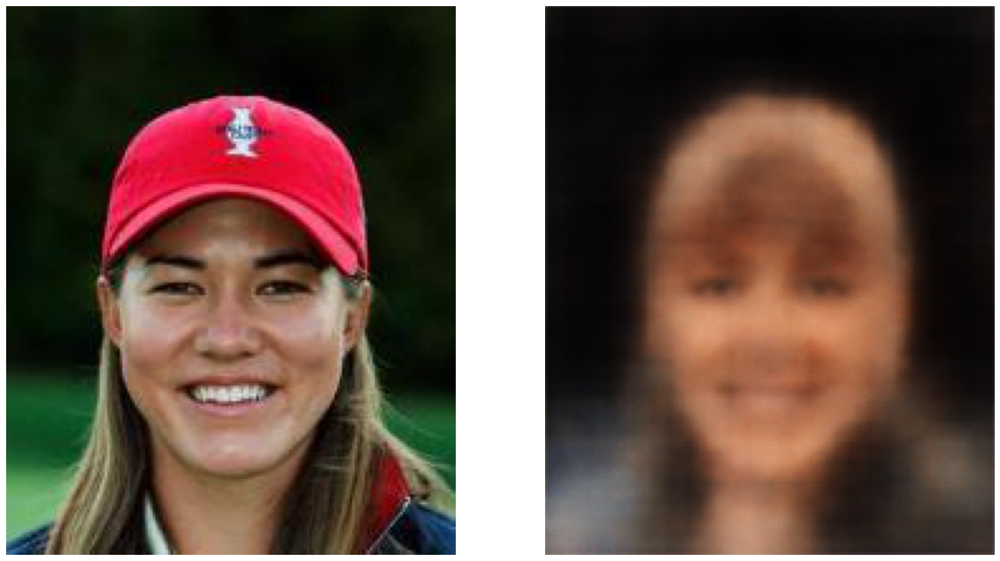

Epoch 6 - Batch 0, Training Loss: 0.0515
Epoch 6 - Batch 100, Training Loss: 0.0528
Epoch 6 - Batch 200, Training Loss: 0.0512
Epoch 6, Test Loss: 15.3135


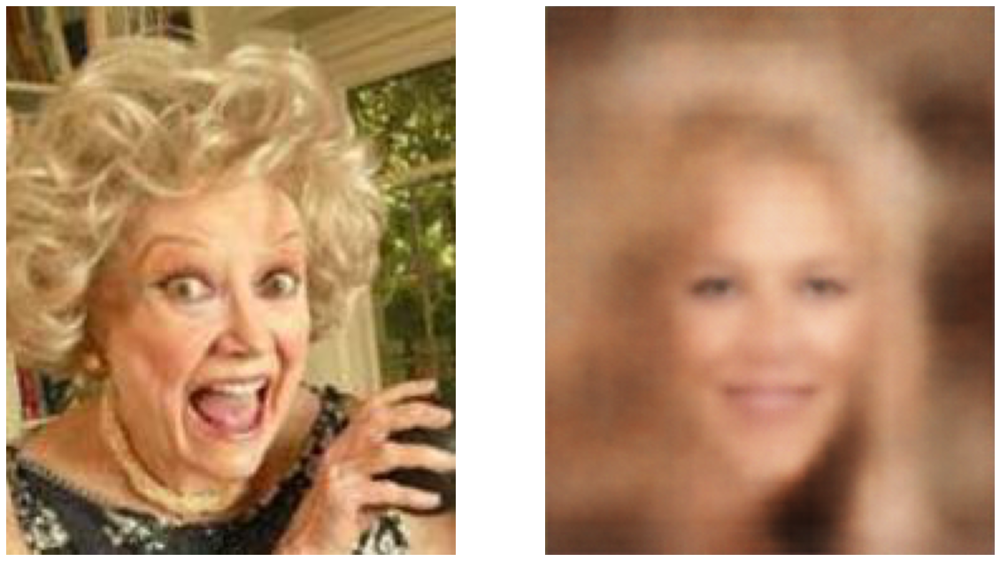

Epoch 7 - Batch 0, Training Loss: 0.0503
Epoch 7 - Batch 100, Training Loss: 0.0505
Epoch 7 - Batch 200, Training Loss: 0.0522
Epoch 7, Test Loss: 15.2855


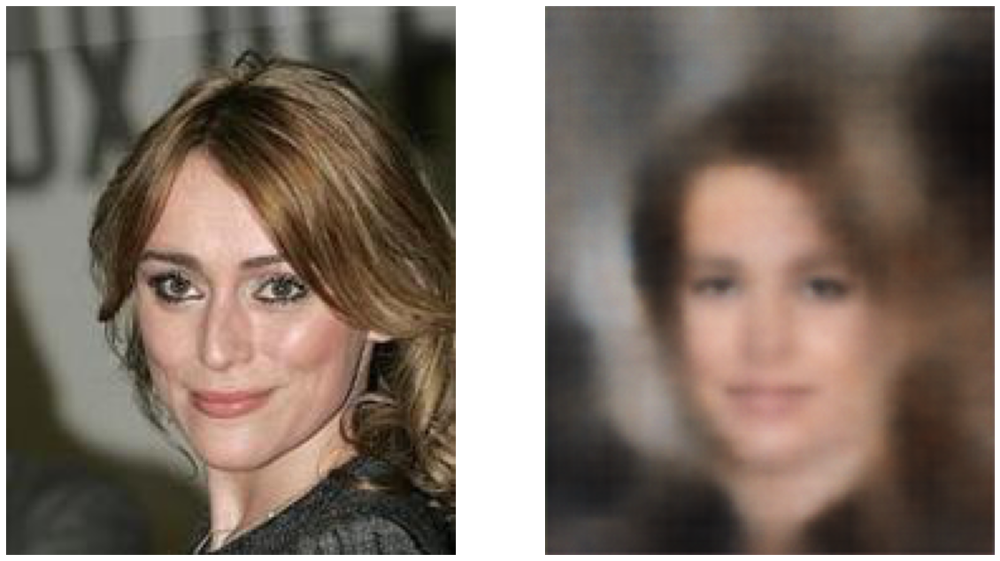

Epoch 8 - Batch 0, Training Loss: 0.0496
Epoch 8 - Batch 100, Training Loss: 0.0476
Epoch 8 - Batch 200, Training Loss: 0.0507
Epoch 8, Test Loss: 14.8179


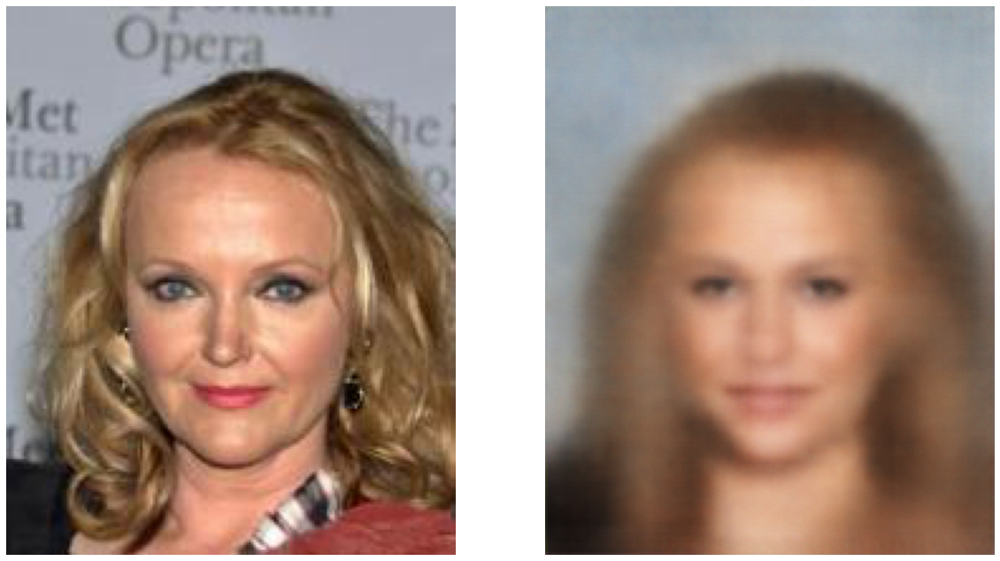

Epoch 9 - Batch 0, Training Loss: 0.0524
Epoch 9 - Batch 100, Training Loss: 0.0510
Epoch 9 - Batch 200, Training Loss: 0.0520
Epoch 9, Test Loss: 14.6566


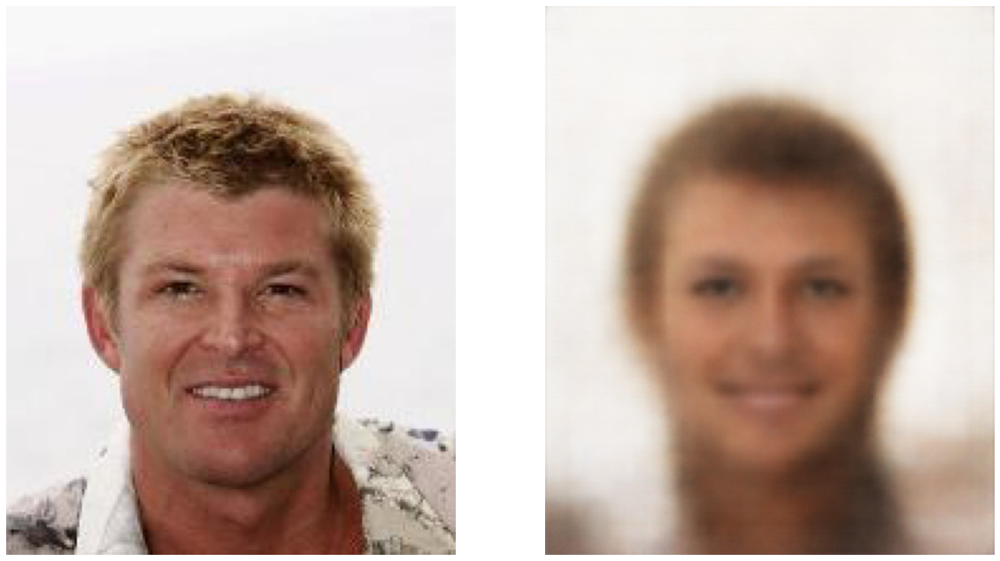

Epoch 10 - Batch 0, Training Loss: 0.0469
Epoch 10 - Batch 100, Training Loss: 0.0497
Epoch 10 - Batch 200, Training Loss: 0.0504
Epoch 10, Test Loss: 14.6812


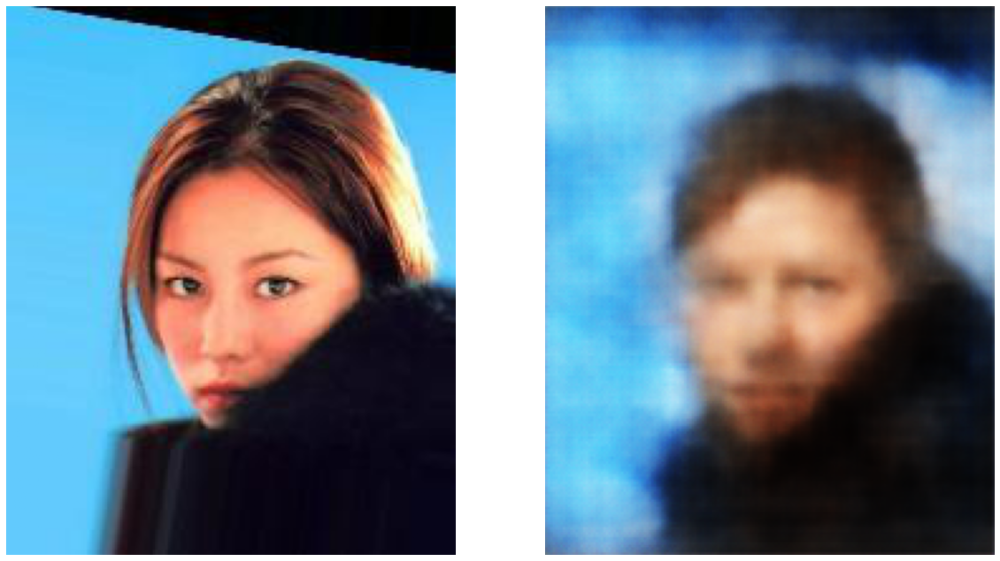

Epoch 11 - Batch 0, Training Loss: 0.0503
Epoch 11 - Batch 100, Training Loss: 0.0477
Epoch 11 - Batch 200, Training Loss: 0.0503
Epoch 11, Test Loss: 14.4179


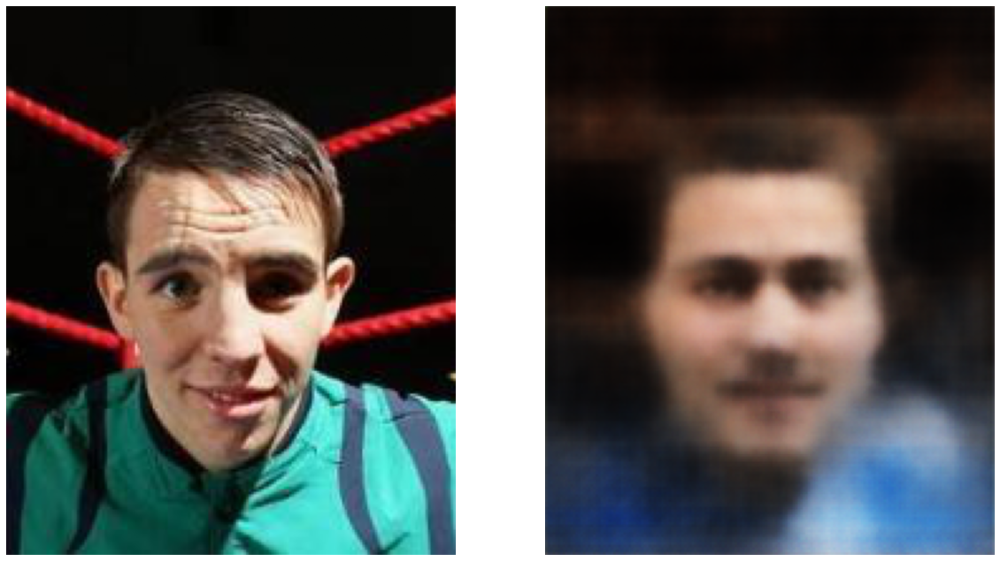

Epoch 12 - Batch 0, Training Loss: 0.0484
Epoch 12 - Batch 100, Training Loss: 0.0492
Epoch 12 - Batch 200, Training Loss: 0.0484
Epoch 12, Test Loss: 14.6519


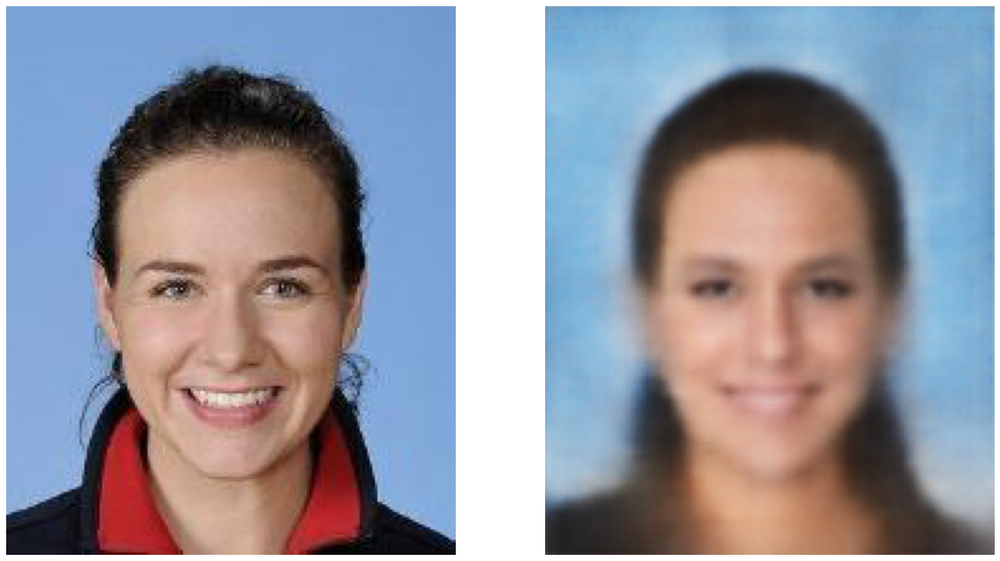

Epoch 13 - Batch 0, Training Loss: 0.0469
Epoch 13 - Batch 100, Training Loss: 0.0471
Epoch 13 - Batch 200, Training Loss: 0.0459
Epoch 13, Test Loss: 14.5314


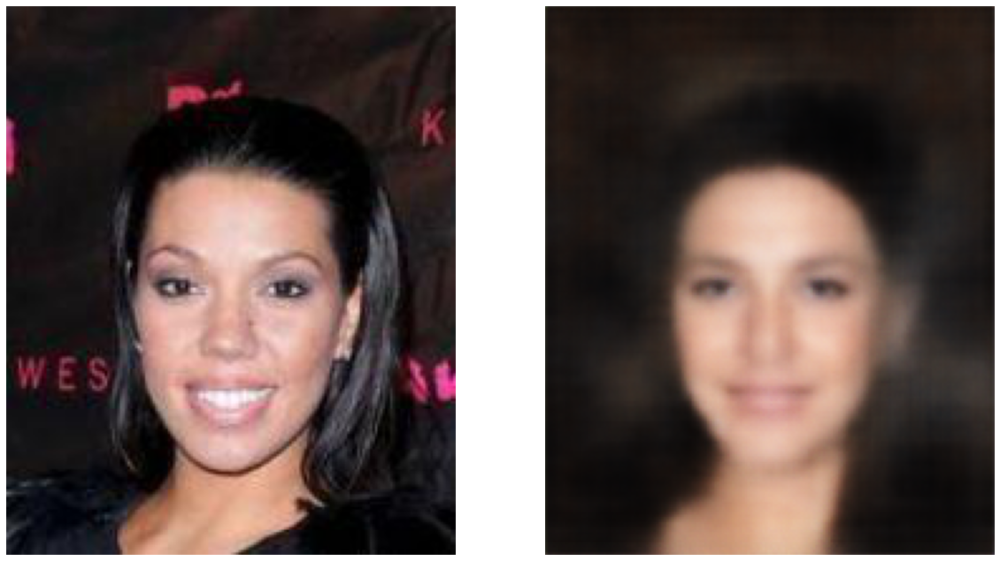

Epoch 14 - Batch 0, Training Loss: 0.0467
Epoch 14 - Batch 100, Training Loss: 0.0461
Epoch 14 - Batch 200, Training Loss: 0.0462
Epoch 14, Test Loss: 14.6500


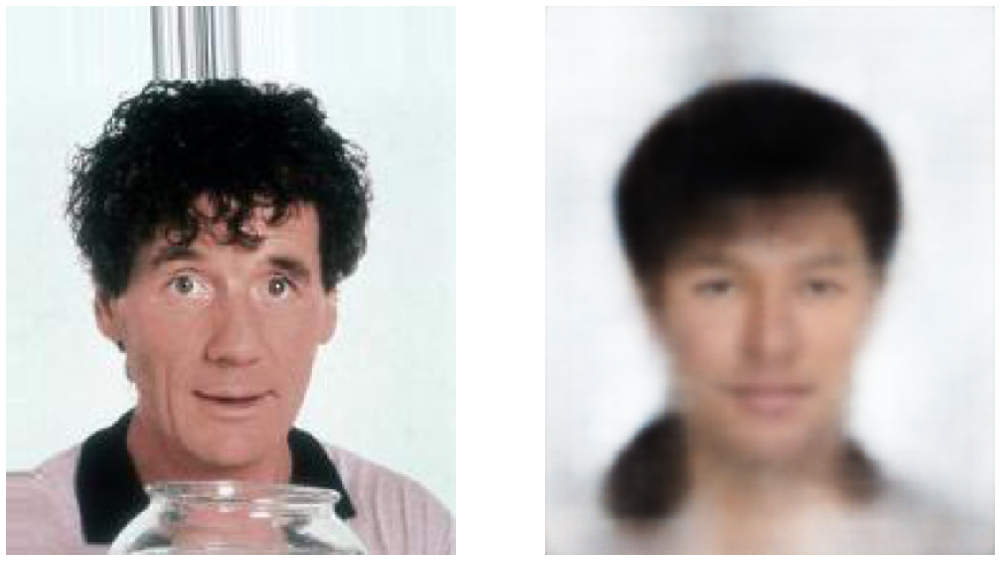

Epoch 15 - Batch 0, Training Loss: 0.0506
Epoch 15 - Batch 100, Training Loss: 0.0452
Epoch 15 - Batch 200, Training Loss: 0.0472
Epoch 15, Test Loss: 14.4250


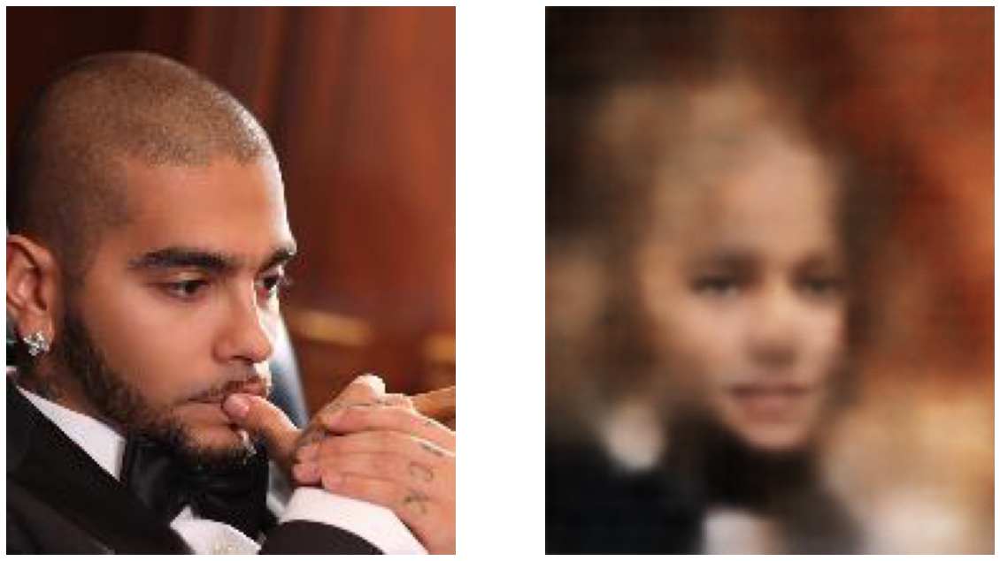

Epoch 16 - Batch 0, Training Loss: 0.0466
Epoch 16 - Batch 100, Training Loss: 0.0479
Epoch 16 - Batch 200, Training Loss: 0.0453
Epoch 16, Test Loss: 14.2013


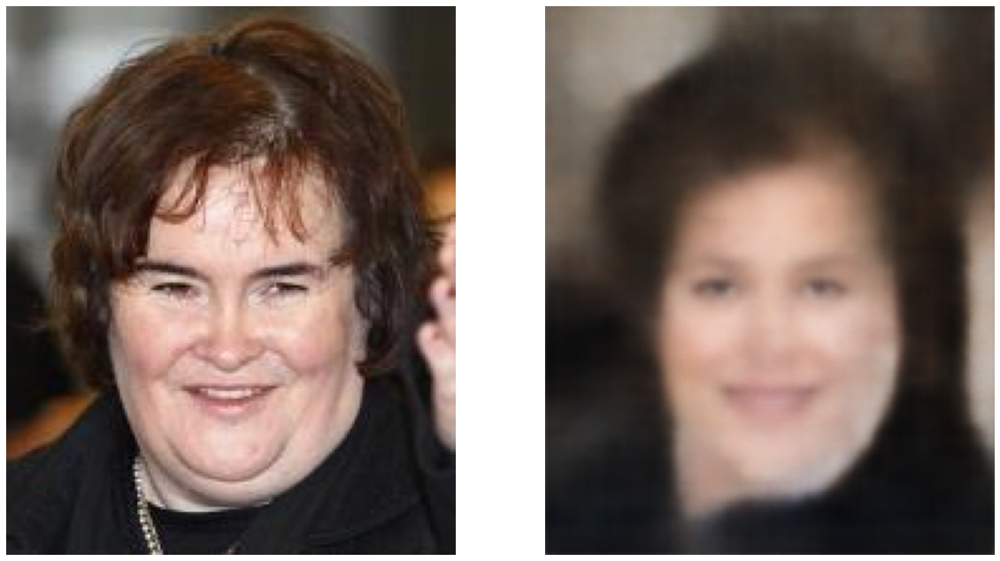

Epoch 17 - Batch 0, Training Loss: 0.0459
Epoch 17 - Batch 100, Training Loss: 0.0453
Epoch 17 - Batch 200, Training Loss: 0.0472
Epoch 17, Test Loss: 14.3784


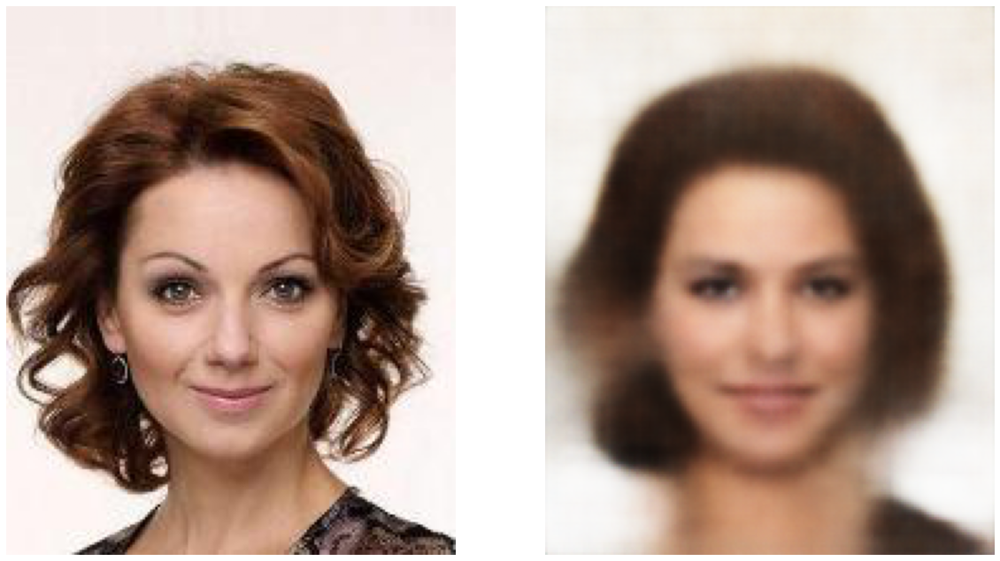

Epoch 18 - Batch 0, Training Loss: 0.0463
Epoch 18 - Batch 100, Training Loss: 0.0459
Epoch 18 - Batch 200, Training Loss: 0.0483
Epoch 18, Test Loss: 14.4053


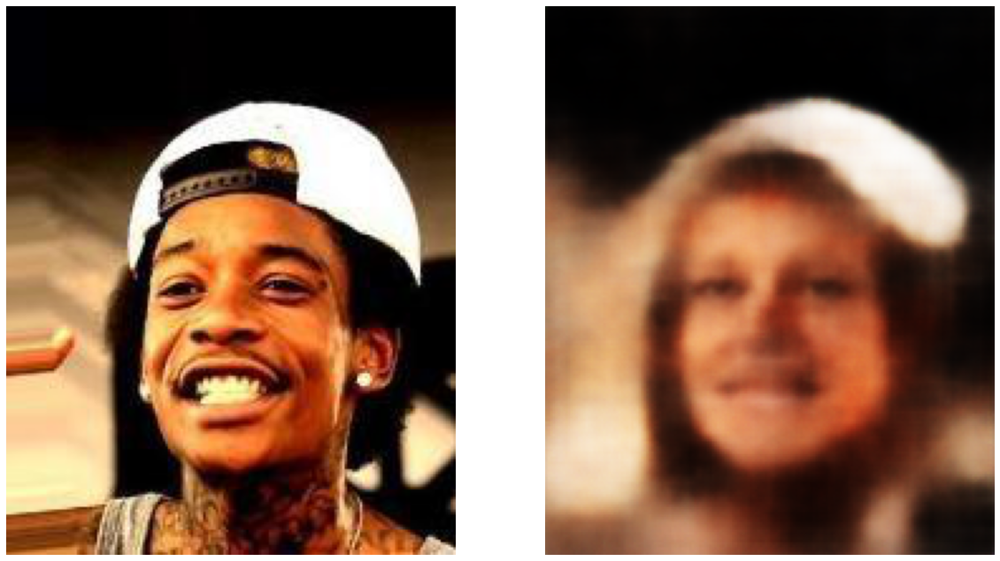

Epoch 19 - Batch 0, Training Loss: 0.0479
Epoch 19 - Batch 100, Training Loss: 0.0481
Epoch 19 - Batch 200, Training Loss: 0.0464
Epoch 19, Test Loss: 14.0071


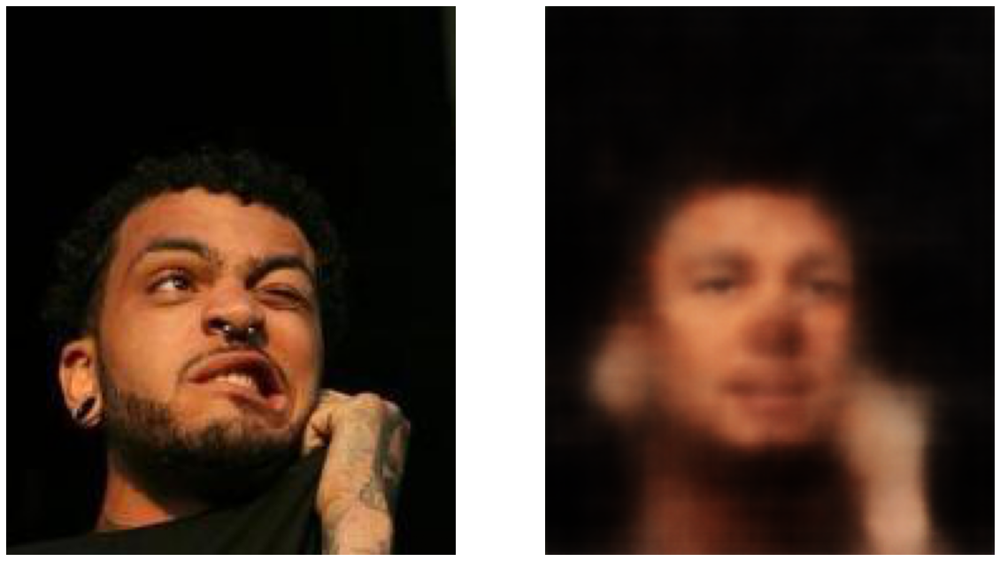

Epoch 20 - Batch 0, Training Loss: 0.0467
Epoch 20 - Batch 100, Training Loss: 0.0490
Epoch 20 - Batch 200, Training Loss: 0.0484
Epoch 20, Test Loss: 13.9905


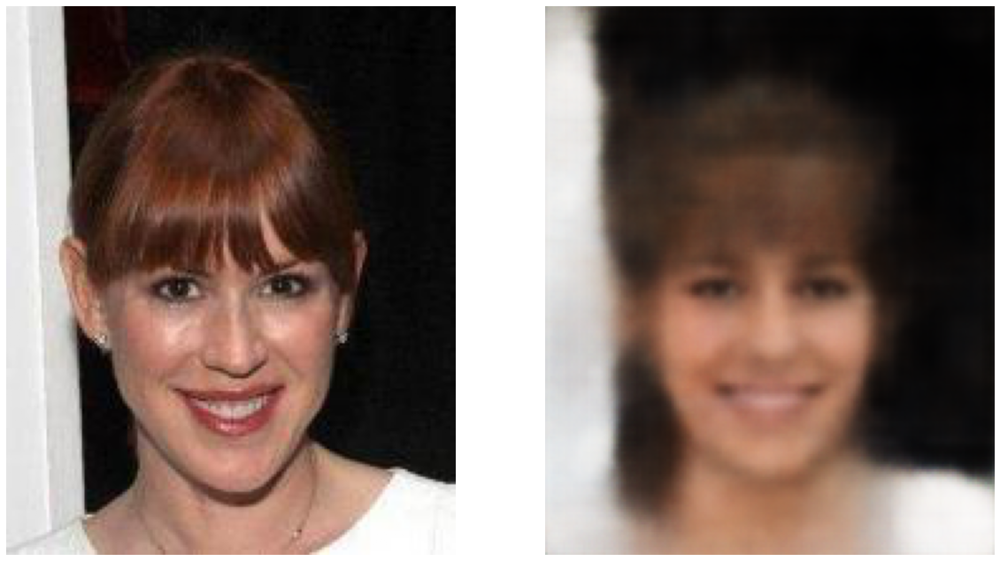

Epoch 21 - Batch 0, Training Loss: 0.0433
Epoch 21 - Batch 100, Training Loss: 0.0452
Epoch 21 - Batch 200, Training Loss: 0.0479
Epoch 21, Test Loss: 14.4856


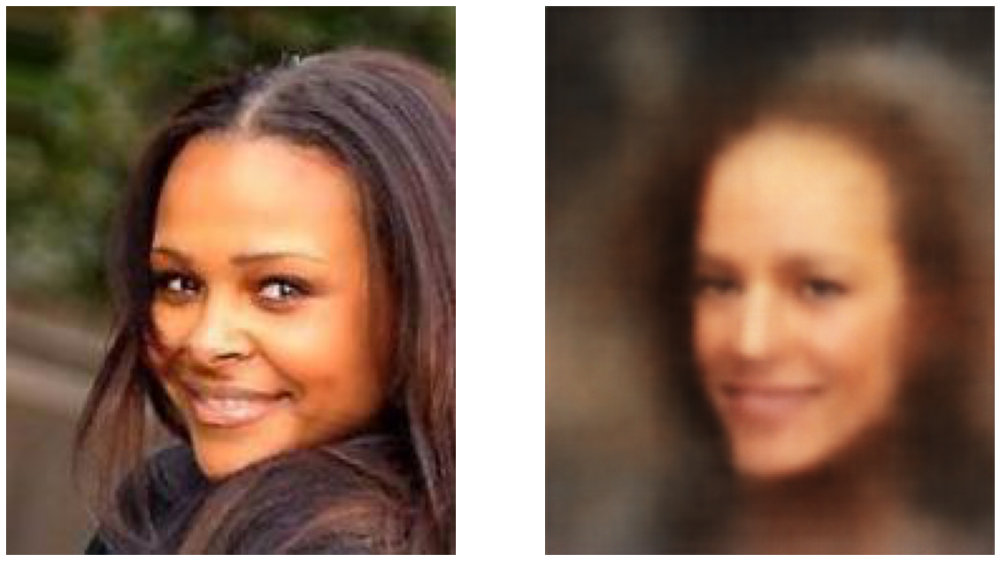

Epoch 22 - Batch 0, Training Loss: 0.0463
Epoch 22 - Batch 100, Training Loss: 0.0450
Epoch 22 - Batch 200, Training Loss: 0.0488
Epoch 22, Test Loss: 13.8975


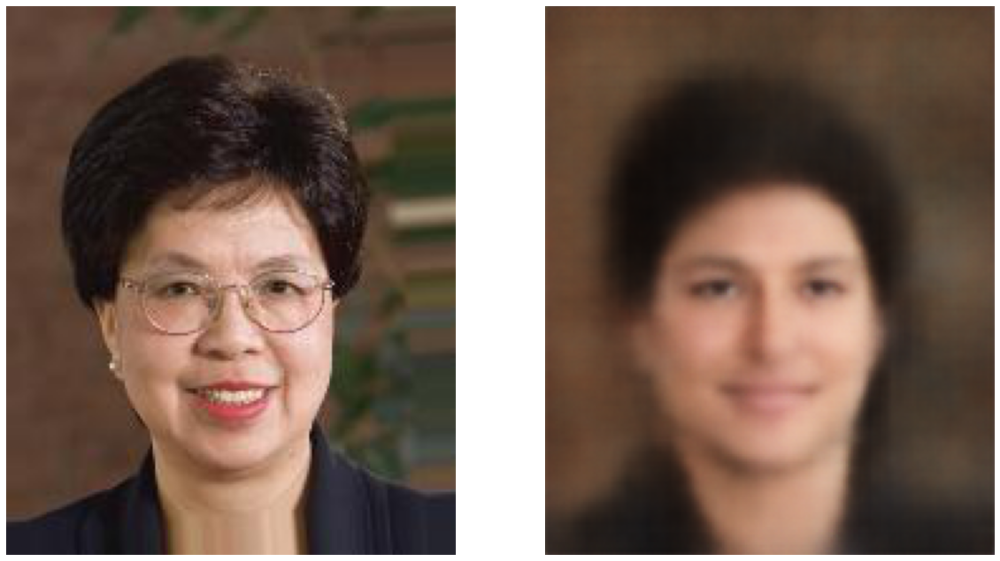

Epoch 23 - Batch 0, Training Loss: 0.0458
Epoch 23 - Batch 100, Training Loss: 0.0471
Epoch 23 - Batch 200, Training Loss: 0.0461
Epoch 23, Test Loss: 14.1599


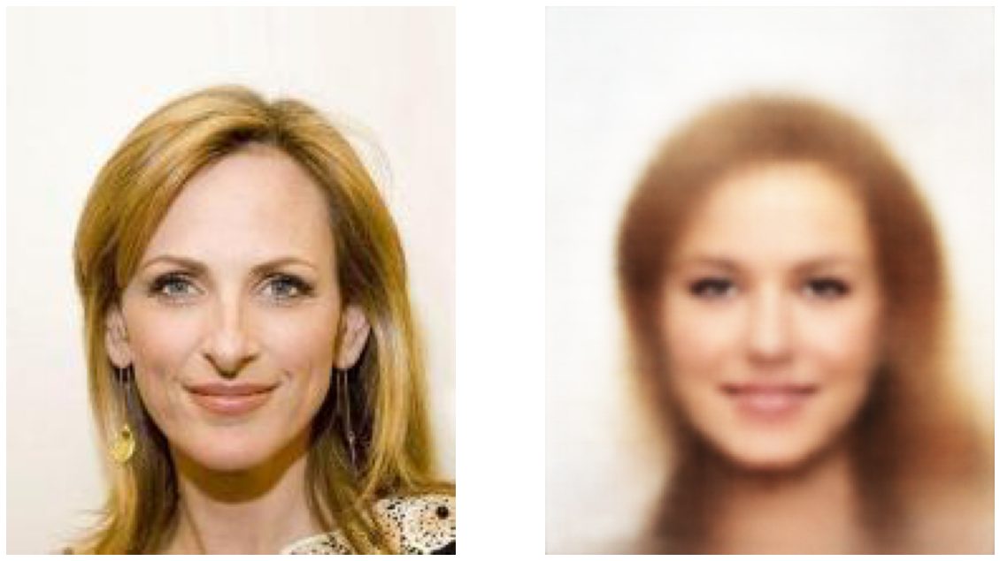

Epoch 24 - Batch 0, Training Loss: 0.0444
Epoch 24 - Batch 100, Training Loss: 0.0461
Epoch 24 - Batch 200, Training Loss: 0.0444
Epoch 24, Test Loss: 14.0520


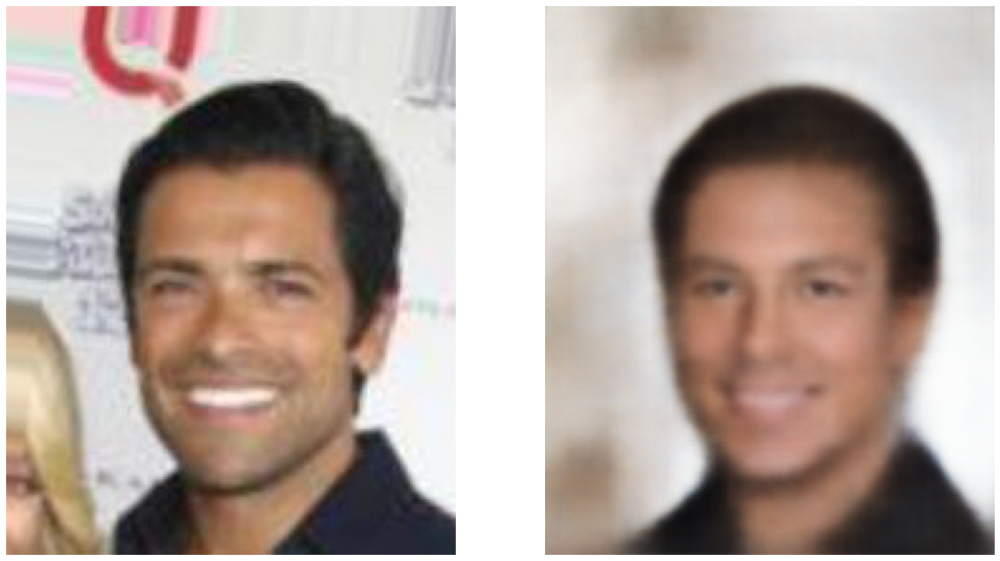

In [ ]:
latent2 = 64 

if torch.cuda.is_available():
    model_2 = VAE(enc_in_chnl,enc_num_hidden,dec_in_chnl,dec_num_hidden,latent2).cuda()
    model_2.weight_init(mean=0, std=0.02)
else:
    model_2 = VAE(enc_in_chnl,enc_num_hidden,dec_in_chnl,dec_num_hidden,latent2)
    model_2.weight_init(mean=0, std=0.02)

train_loss_lst2, train_iters2 , test_loss_lst2 , val_iters2 =train(model_2  ,learning_rate = 0.0001, batch_size = 100 , num_epochs=25,
                                                                    checkpoint_path='/content/gdrive/MyDrive/DP_course/ex4/checkpoints2/ckpt-{}.pk')

In [ ]:
torch.cuda.empty_cache()

In [ ]:
train_loss_lst22 = np.array(train_loss_lst2)
np.save('/content/gdrive/MyDrive/DP_course/ex4/checkpoints2/train_loss_lst2' ,train_loss_lst22 )
test_loss_lst22 = np.array(test_loss_lst2)
np.save('/content/gdrive/MyDrive/DP_course/ex4/checkpoints2/test_loss_lst2' ,test_loss_lst22 )

Plot the train and the validation loss graphs. Explain what is seen.

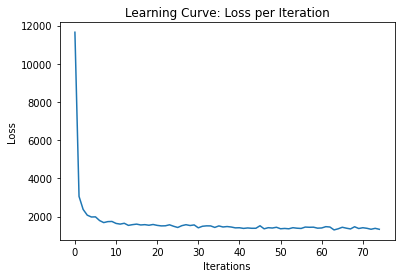

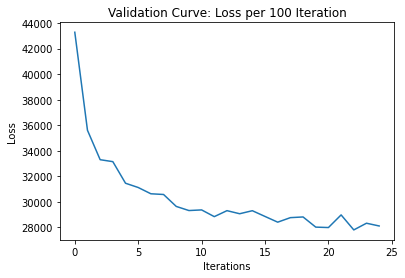

In [ ]:
plot_learning_curve( [x for x in range(75)], train_loss_lst2, [x for x in range(25)],test_loss_lst2 )

We chose a much bigger latent space of n = 64 then the previous section. 

This time we can see a much better outcome than the previous model , looking at the graph the loss this time is much smaller an does have some decrease over the iterations but it gained its main learning in the first few itarations.

In [ ]:
latent2 = 64 
model_2 = VAE(enc_in_chnl,enc_num_hidden,dec_in_chnl,dec_num_hidden,latent2)
model_2.to(device)
model_2.load_state_dict(torch.load('/content/gdrive/MyDrive/DP_course/ex4/checkpoints2/ckpt-25.pk'))

<All keys matched successfully>

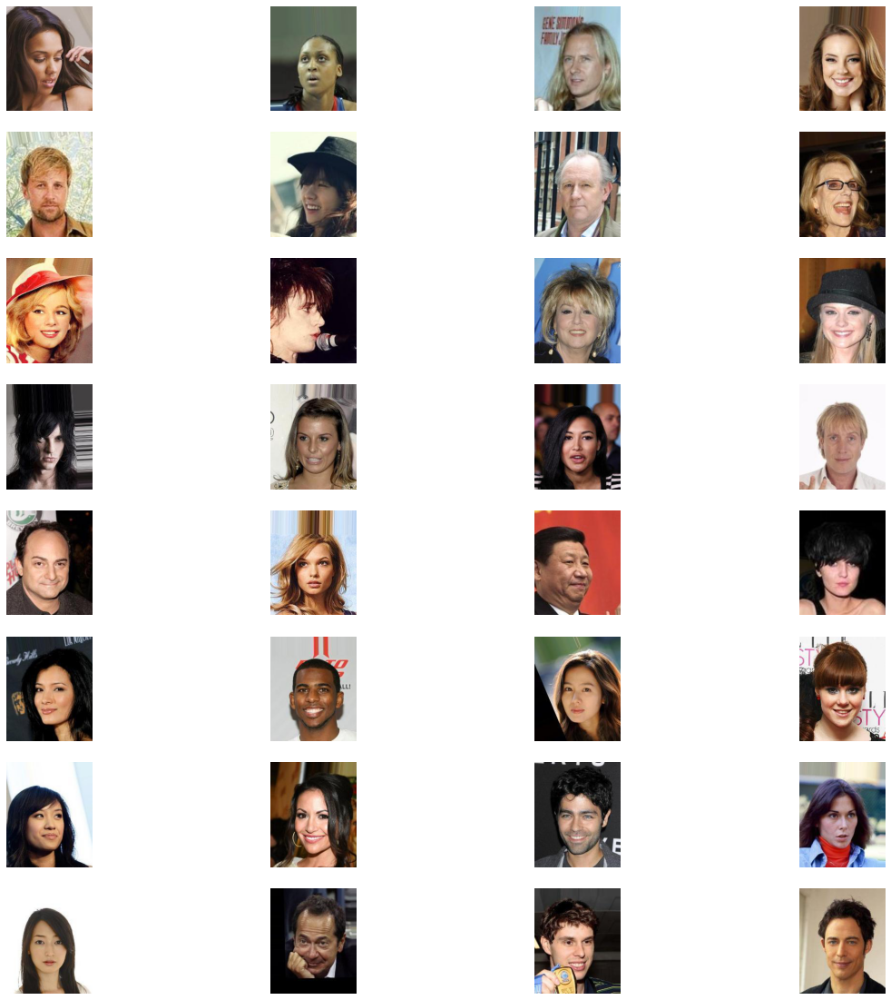

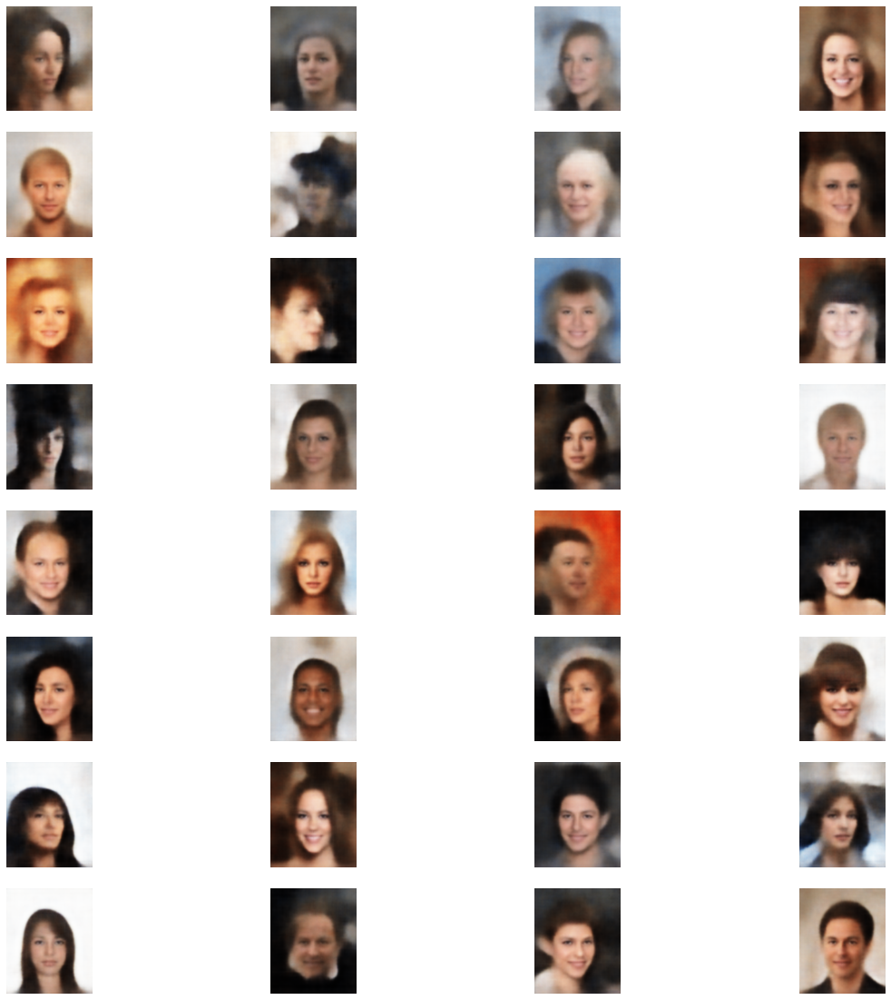

In [ ]:
# Your Code Goes Here
dataloader = torch.utils.data.DataLoader(training_data, batch_size=32, shuffle=True)

lst_img = []
lst_recon_img = []
n = 0
# Store 4 images in lst_img
for y, _ in (dataloader):
  img = y.to(device)
  recon_img, mu, logvar = model_2(img)
  std = torch.exp(0.5 * logvar.detach())
  #mu = mu.detach()   
  while n<32:
      # Convert the image tensor to a NumPy array
    image = y.cpu().numpy()[n]
    image = image.swapaxes(0,2).swapaxes(0,1)
    lst_img.append(image)
    
    
    
    # Convert the image tensor to a NumPy array
    
    recon_img_n = recon_img.cpu().detach()[n]

    #recon_img = recon_img.cpu().numpy()[0]
    recon_img_n = recon_img_n.swapaxes(0,2).swapaxes(0,1)
    lst_recon_img.append(recon_img_n)
    n+=1
  break


# Display the image using the imshow function
show(lst_img,8,4)
show(lst_recon_img,8,4)


Visualize, from the test dataset, an original image against a reconstructed image. Has the model reconstructed the image successfully? Are the images identical? Explain.

**Answer:**

As we can see, the reconstruction is still blurry but much less than the previous model, we can see different faces , different skin colors and expressions as well it is more detailed in the background with changing colors.

 What will happened if we choose extremely high dimension for the latent space?

**Answer:**

In a VAE (Variational Autoencoder) model, the latent space is a lower-dimensional space that represents the input data. The dimensionality of this space is a hyperparameter of the VAE model that we can specify when we are training the model.

Increasing the dimensionality of the latent space allows the VAE model to represent more complex distributions of the input data, and it can result in more accurate reconstructions of the input data when the VAE is used for reconstruction. **However, increasing the dimensionality of the latent space also increases the number of parameters in the model, which can increase the risk of overfitting**.

On the other hand, decreasing the dimensionality of the latent space reduces the model's capacity to represent complex distributions of the input data, which can result in poorer reconstructions of the input data. However, a lower-dimensional latent space can also help to reduce the risk of overfitting, since the model has fewer parameters.

In general, it is a trade-off between model capacity and overfitting. The appropriate dimensionality of the latent space will depend on the complexity of the data and the amount of training data available. It is generally a good idea to start with a relatively low-dimensional latent space and then increase the dimensionality if necessary, while keeping an eye on the performance of the model.

 
Did you output blurry reconstructed images? If the answer is yes, explain what could be the reason. If you got sharp edges and fine details, explain what you did in order to achieve that. 

Note: If you got blurry reconstructed images, just explain why. You dont need to change your code or retrain your model for better results (as long as your results can be interpreted as a human face).
 


**Answer:**

Yes we got blurry reconstructed images. The dimension 64 is larger than 3 and should in theory lead to better reconstruction. However, the CelebA dataset we are using is a large and **complex (a lot of features)** dataset and 64 dimensions may not be sufficient to fully capture all the variations in the data. In addition, note that while importing the data, we kept our images to be of size (218,178) which meand that 64 may still be considered as a small dimension in respect to our number of features.

## Question 6: Generate New Faces (10 %)

Now, for the fun part!

We are going to generate new celebrity faces with our VAE models. A function for new faces generation is given to you. Modify it (if needed) to fit your code. 



In [ ]:
# creates random noise sample in the correct shape.
def generate_faces(model, grid_size, latent):
    model.eval()
    dummy = torch.empty([32,latent])

    # std_mean=(std.cpu().mean(dim=0)).numpy().reshape(-1,1)
    # std_mean = torch.tensor(np.ones((32,1))@ std_mean.T,dtype = torch.float32)

    # mu_mean=(mu.detach().cpu().mean(dim=0)).numpy().reshape(-1,1)
    # mu_mean = torch.tensor(np.ones((32,1))@ mu_mean.T,dtype = torch.float32)

    # eps = torch.randn_like(dummy).cpu()

    # z= (eps.mul(std_mean).add_(mu_mean)).to(device)
    z = torch.randn_like(dummy).to(device)

    #insert the random noise to the decoder to create new samples.
    sample = model.decode(z)
    new_face_list = []

    j=0
    while j < grid_size: 
        new_face_list.append(sample[j].cpu().detach())
        j+=1

    show(new_face_list)

**Model 1 ($L = 3$) results:**

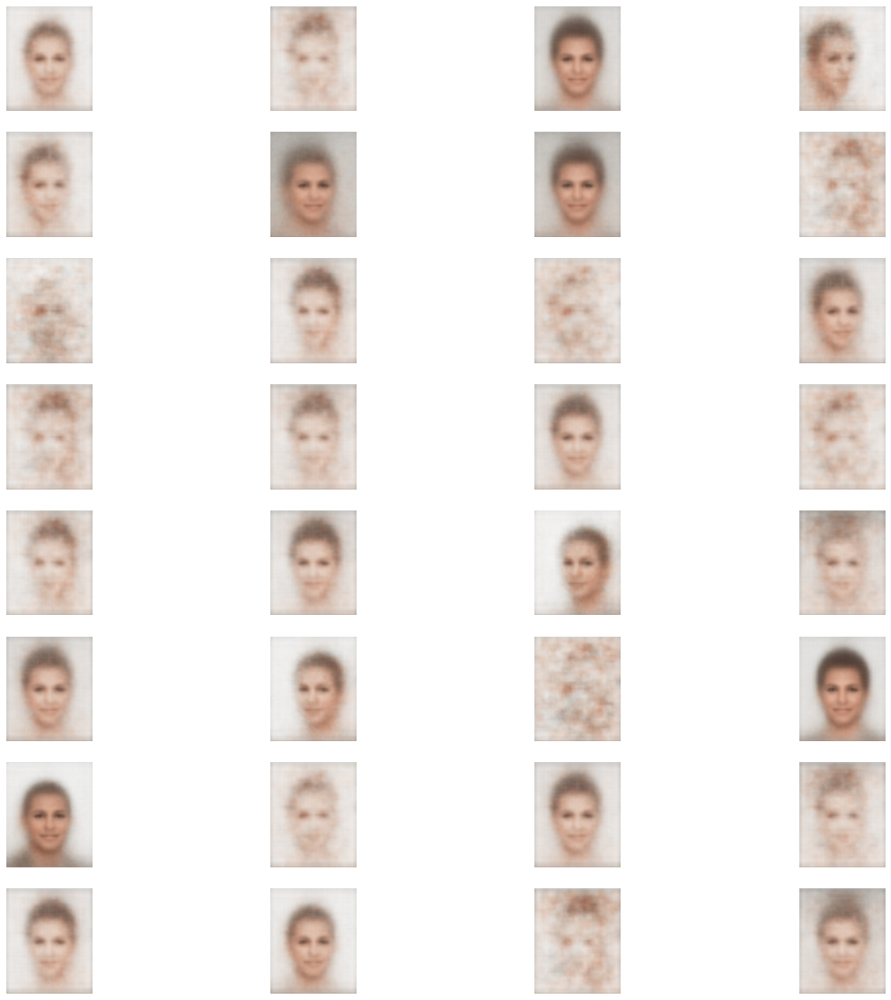

In [ ]:
generate_faces(model_1,grid_size=32,latent=latent1)

**Model 2 results:**

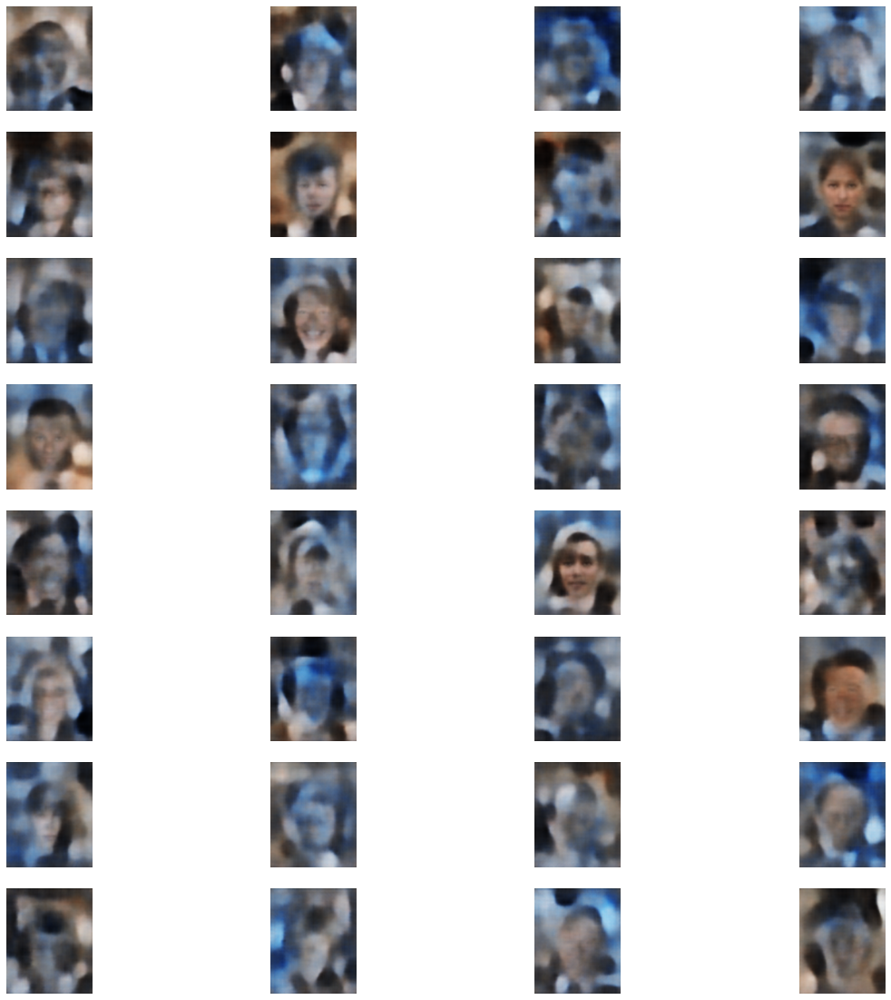

In [ ]:
generate_faces(model_2,grid_size=32,latent=latent2)

torch.float32
torch.float32


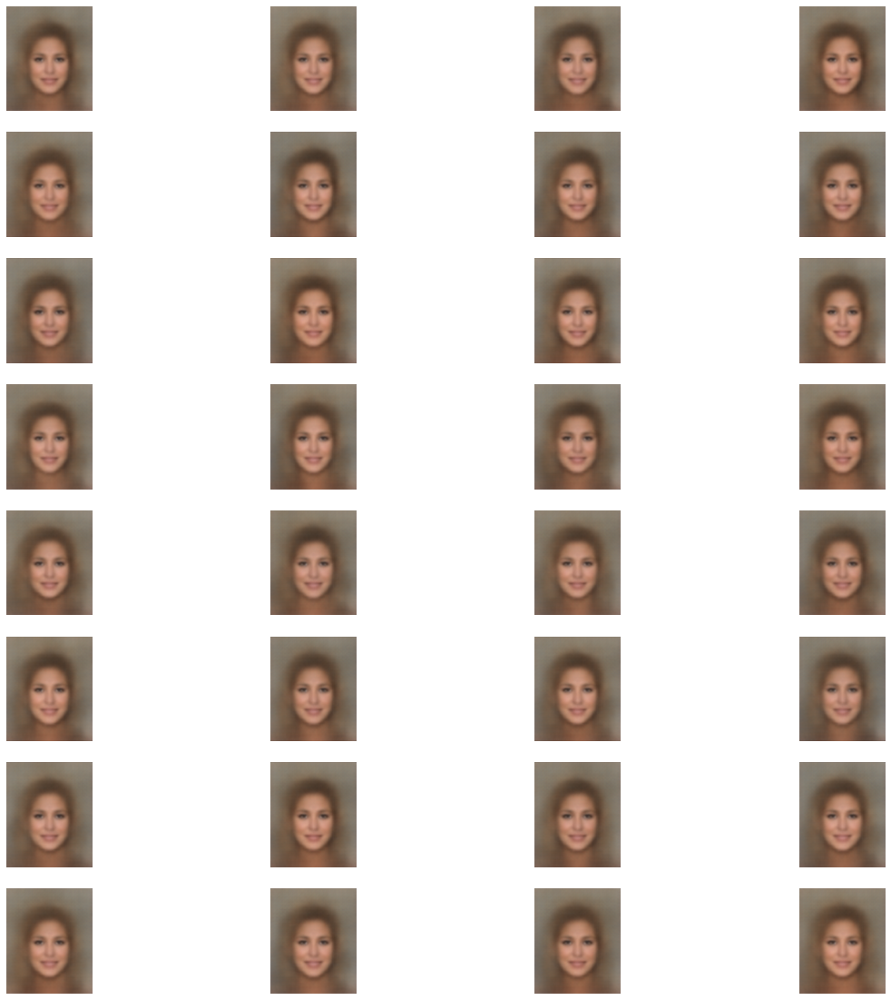

In [ ]:
generate_faces(model_2,grid_size=32,latent=latent2)

*Q1:* Generate new faces with VAE model with latent space dimension = 3. Did you get diverse results? What are the most prominent features that the latent space capture? 

*Q2:* Generate new faces with VAE model with your decision for latent space dimension. What are the most prominent features that the latent space capture? 

*Q3:* What are the differences? Your results are similar to the dataset images? Do you get realistic images for your chosen latent space dimension? If not, change your decision or your network to acheive more realistic results.

**Answer**

**Q1:**

By looking at the output we can see that most of the images are blurry and The most prominent features that the latent space captured are the eyes, mouth and nose (in this order).

**Q2:**

For the model with the larger latent space dimension, we expected to see more detailed features in the reconstructed images due to the fact that a larger latent space allows for more information to be encoded and captured, leading to higher resolution and more accurate reconstructions.
Thus, with the 2nd model we see more subtle features such as textures of skin, shapes of eyebrows, color variations in eyes, etc.

**Q3:**

Regarding the differences between the models- The difference reflected in the variety of features that we see in the reconstructed images.

Regarding the results in both models- VAE is a generative model, which means that it tries to learn the underlying **probability distribution** of **our** training data, while the reconstructed images are not exact copies of the original images. They are samples from the estimated probability distribution of the data.
Note that here, our goal was to generate new faces, thus we didn't took a real image and generated its real latent representation, what we actually did was to generate **some** random latent representation and see how the decoder creates new image out of it from the probability distribution it learned.
As we can see, the reconstructed images have some features that may look similar to the features of our data (which make sense due to the probability distribution that our decoder "knows"), but still the images are not so clear and sharp (which also make sense due to the fact that there are a lot of improvement which we still can add/change to the training process of the model in order to make it more accurate and make it to be able to "predict" a more complex inputs)

## Question 7: Extrapolation (10 %)

Recall that we extrapolate in the images domain in Question 2, part (c).
Here, extrapolate in the latent space domain to generate new images.

Define $\beta = [0, 0.1, 0.2, ... , 0.9, 1]$ and randomly sample from $Z \sim \mathcal{N(0,1)}$ 2 different samples and generate 2 new face images: $X_1, X_2$.

Extrapolate in the latent domain as follows: $\beta_i\cdot Z_1 + (1-\beta_i)\cdot Z_2$ for each $\beta_i \in \beta$.

Plot the extrapolation of the images for each $\beta$ and discuss your results. 
Repeat the process for 3 different samples.



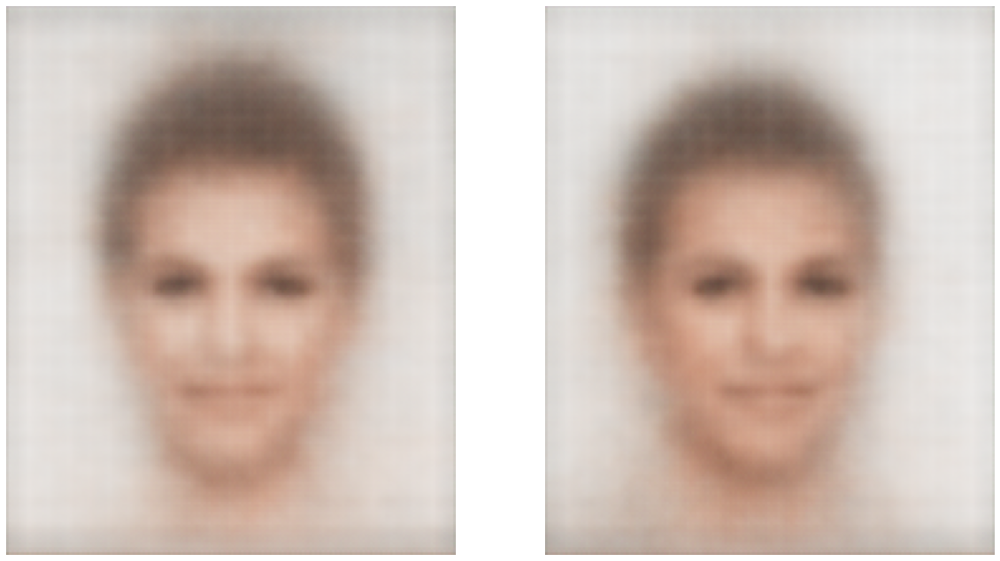

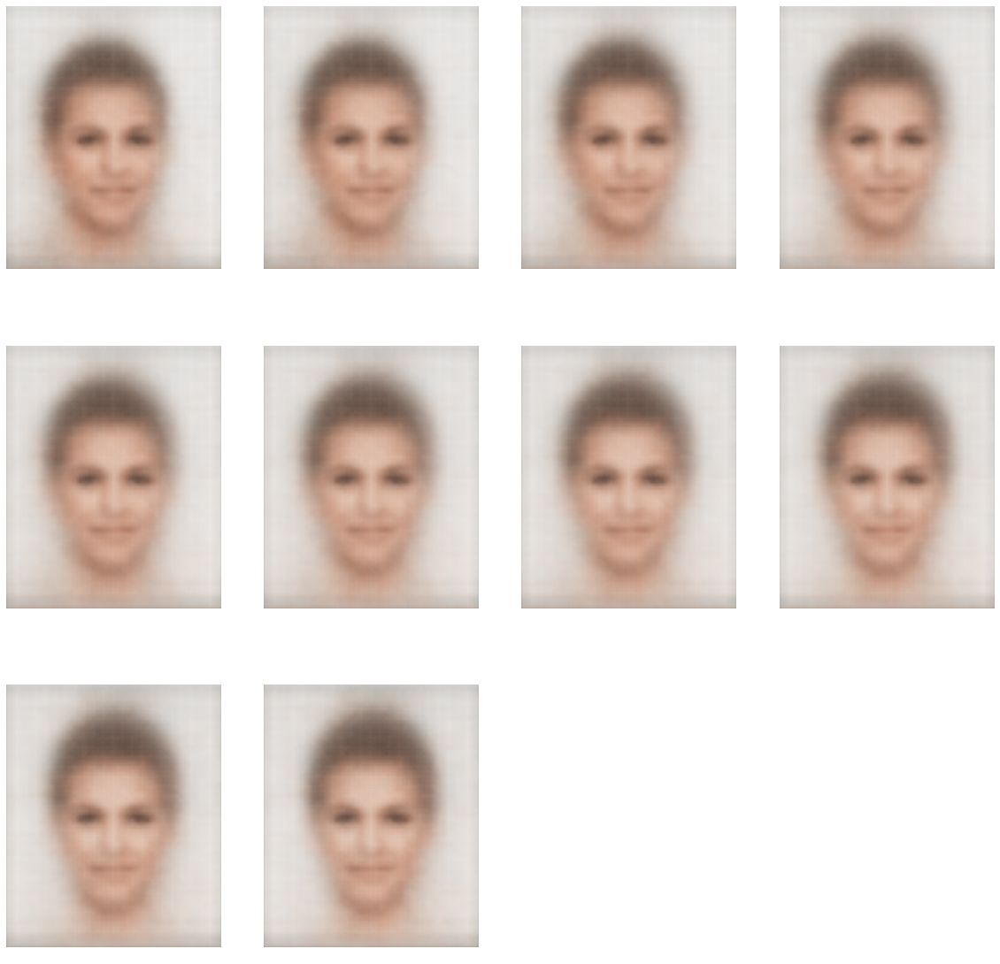

In [ ]:
dummy = torch.empty([2,3])
z = torch.randn_like(dummy).to(device)
b = np.arange(0,1,0.1)
sample = model_1.decode(z).cpu()
sample = sample.detach()
show(sample ,1 , 2)
new_face_list = []
for beta in b:
  summed_image = beta*sample[0] + (1-beta)*sample[1]
  new_face_list.append(summed_image)
show(new_face_list ,3 , 4)

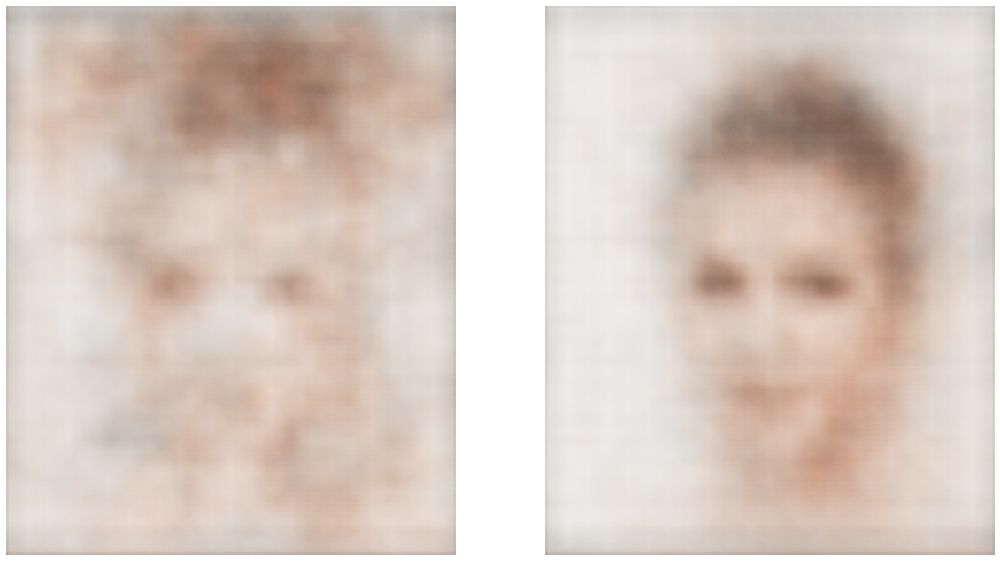

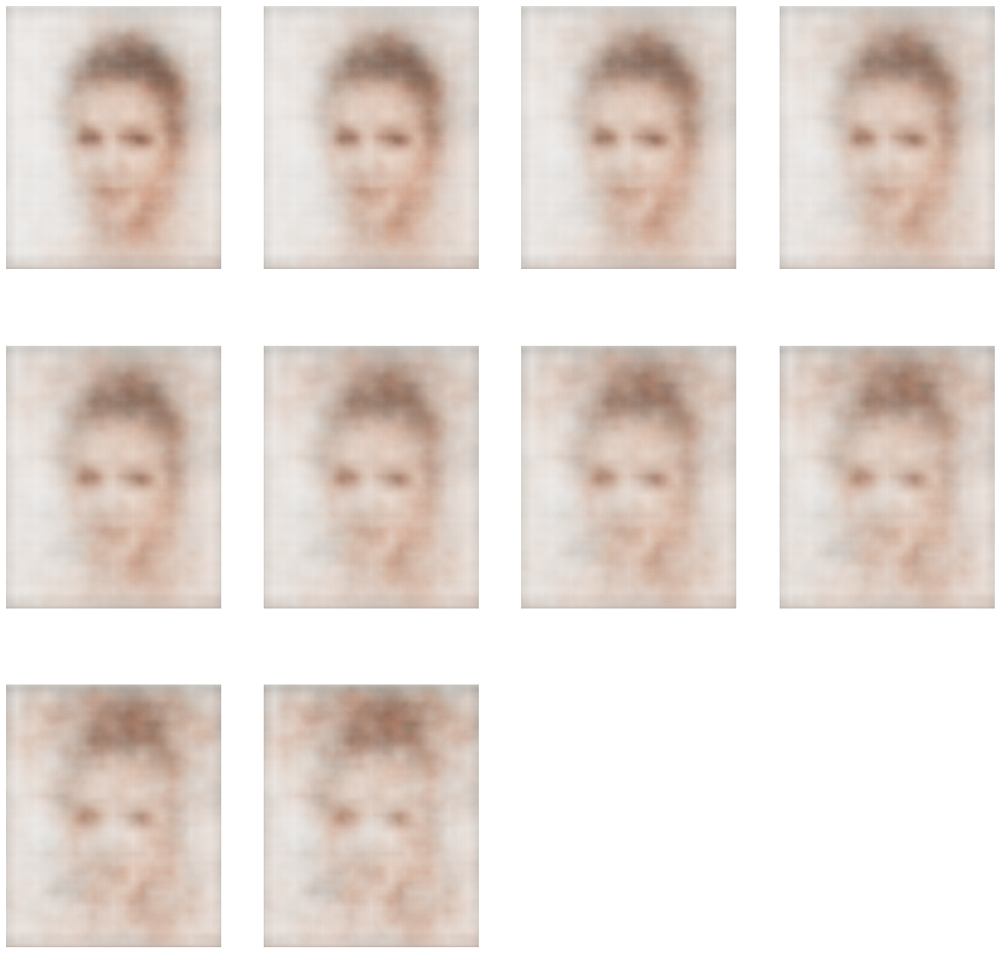

In [ ]:
dummy = torch.empty([2,3])
z = torch.randn_like(dummy).to(device)
b = np.arange(0,1,0.1)
sample = model_1.decode(z).cpu()
sample = sample.detach()
show(sample ,1 , 2)
new_face_list = []
for beta in b:
  summed_image = beta*sample[0] + (1-beta)*sample[1]
  new_face_list.append(summed_image)
show(new_face_list ,3 , 4)

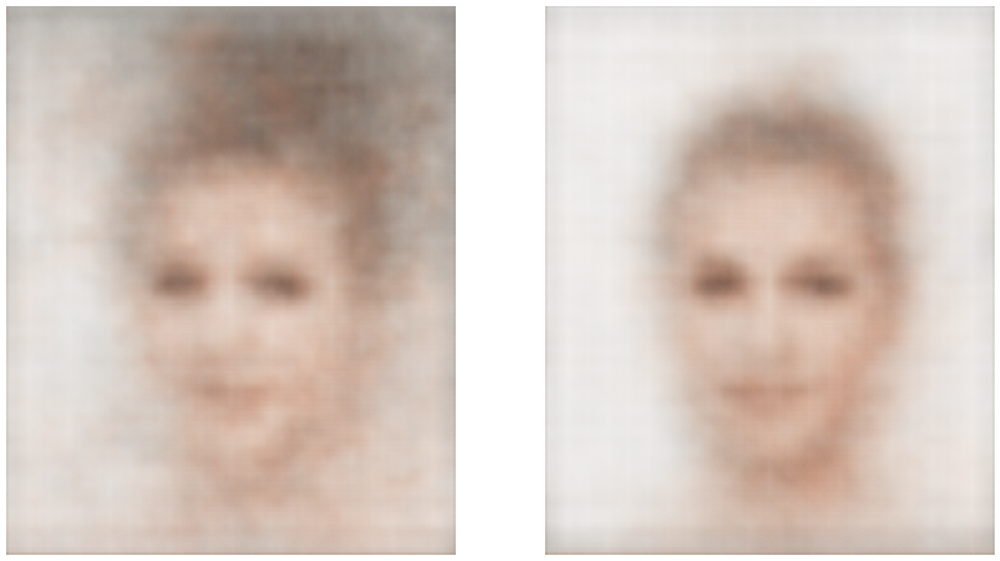

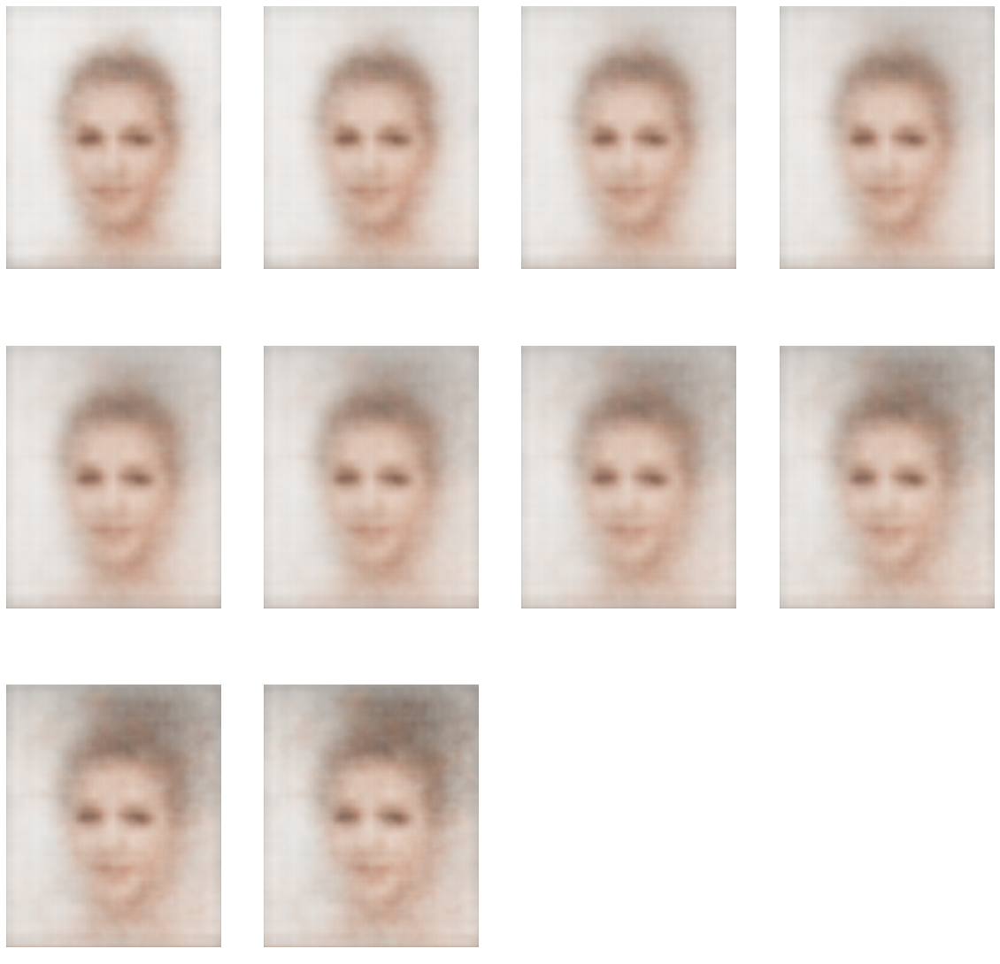

In [ ]:
dummy = torch.empty([2,3])
z = torch.randn_like(dummy).to(device)
b = np.arange(0,1,0.1)
sample = model_1.decode(z).cpu()
sample = sample.detach()
show(sample ,1 , 2)
new_face_list = []
for beta in b:
  summed_image = beta*sample[0] + (1-beta)*sample[1]
  new_face_list.append(summed_image)
show(new_face_list ,3 , 4)

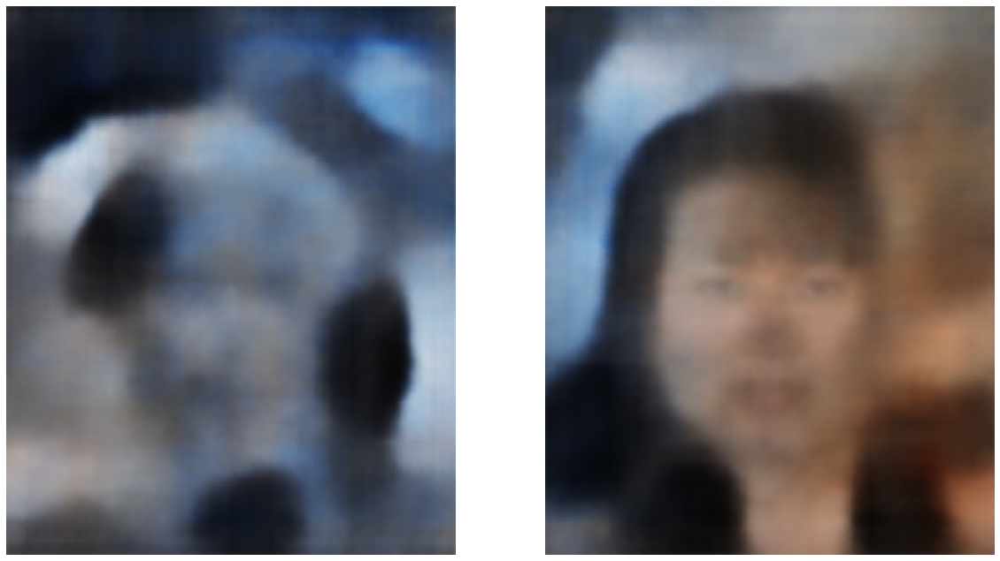

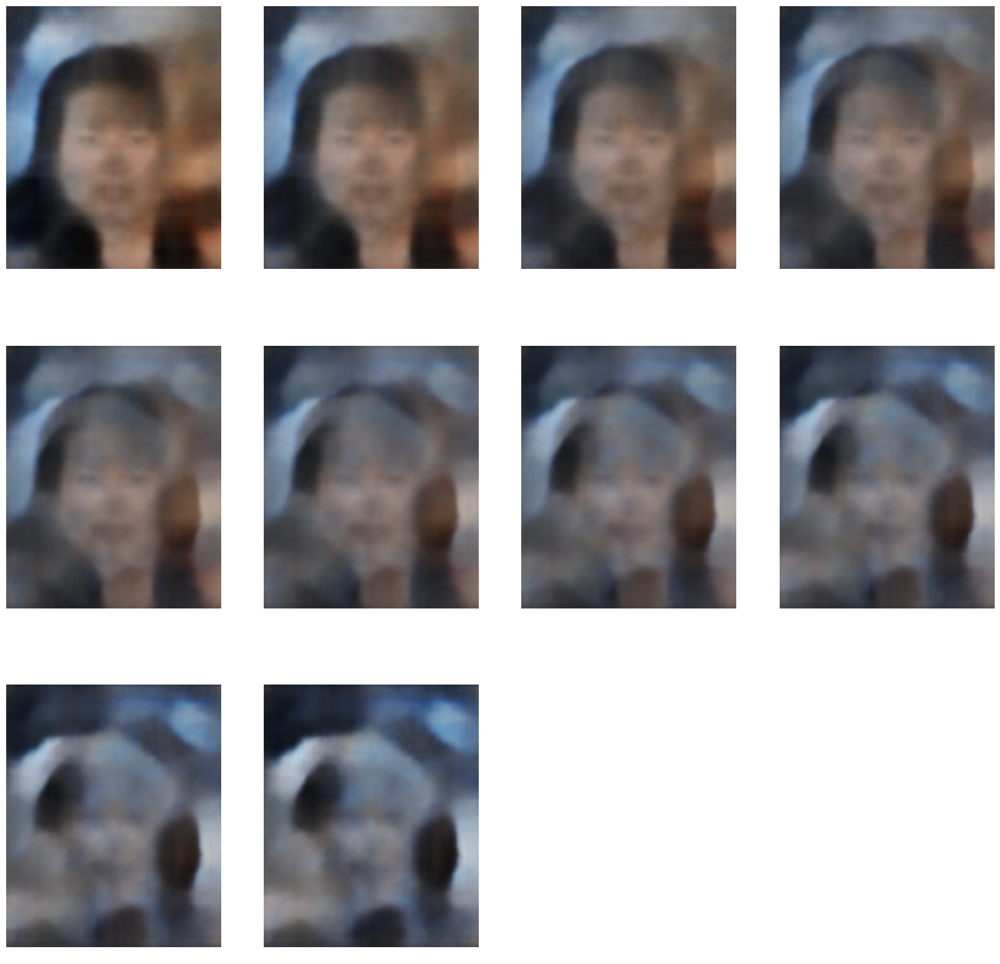

In [ ]:
dummy = torch.empty([2,64])
z = torch.randn_like(dummy).to(device)
b = np.arange(0,1,0.1)
sample = model_2.decode(z).cpu()
sample = sample.detach()
show(sample ,1 , 2)
new_face_list = []
for beta in b:
  summed_image = beta*sample[0] + (1-beta)*sample[1]
  new_face_list.append(summed_image)
show(new_face_list ,3 , 4)

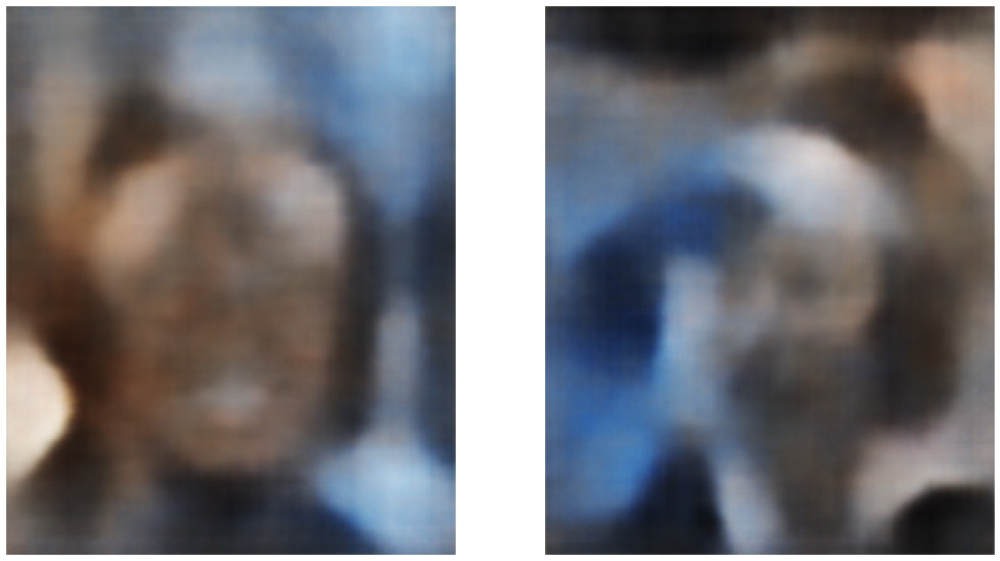

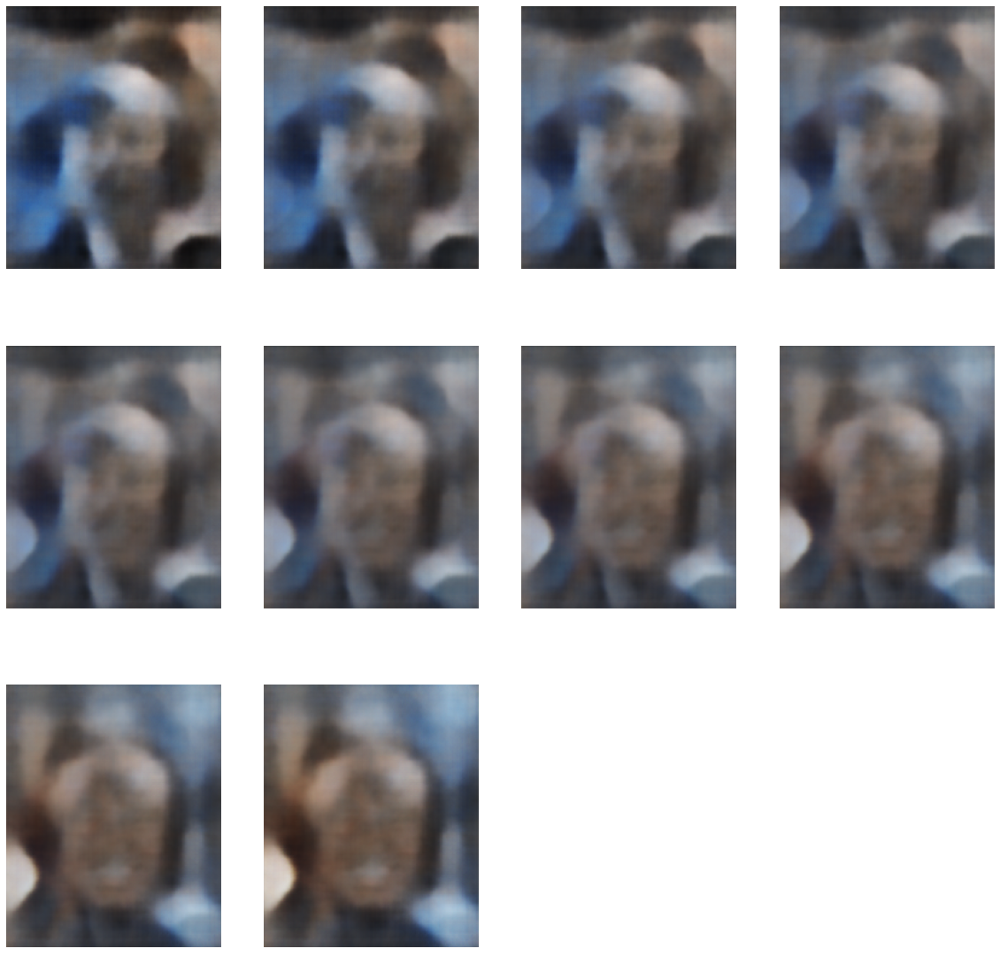

In [ ]:
dummy = torch.empty([2,64])
z = torch.randn_like(dummy).to(device)
b = np.arange(0,1,0.1)
sample = model_2.decode(z).cpu()
sample = sample.detach()
show(sample ,1 , 2)
new_face_list = []
for beta in b:
  summed_image = beta*sample[0] + (1-beta)*sample[1]
  new_face_list.append(summed_image)
show(new_face_list ,3 , 4)

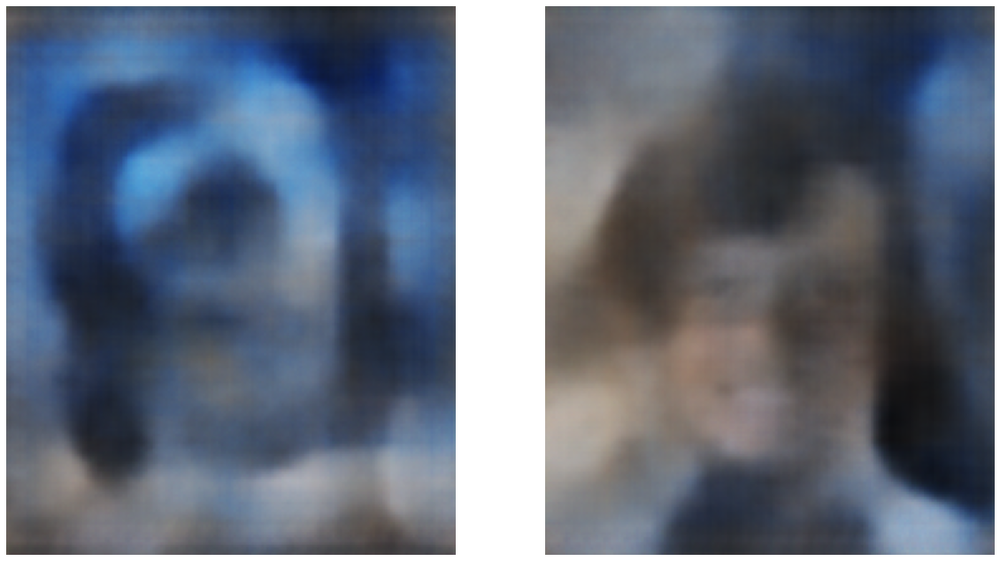

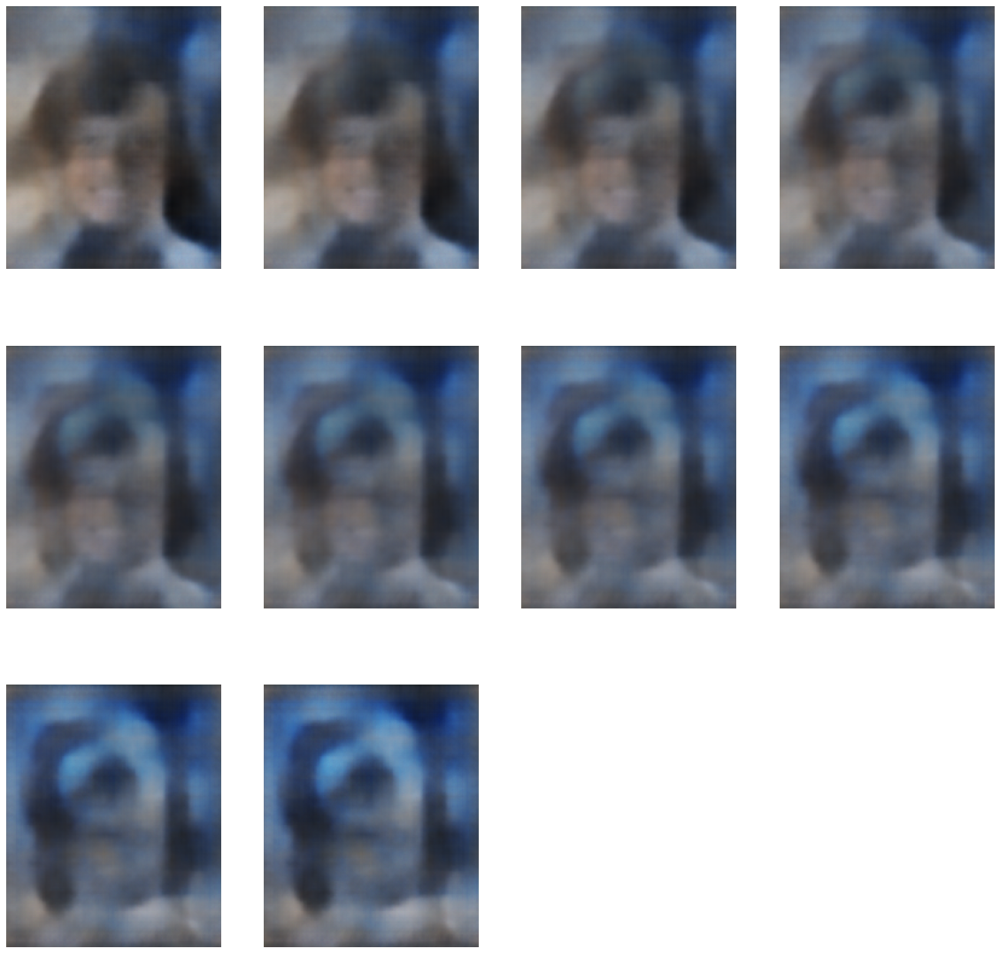

In [ ]:
dummy = torch.empty([2,64])
z = torch.randn_like(dummy).to(device)
b = np.arange(0,1,0.1)
sample = model_2.decode(z).cpu()
sample = sample.detach()
show(sample ,1 , 2)
new_face_list = []
for beta in b:
  summed_image = beta*sample[0] + (1-beta)*sample[1]
  new_face_list.append(summed_image)
show(new_face_list ,3 , 4)